# Ptychography Tutorial 03

This is the third tutorial notebook in the iterative ptychography series.  
In this tutorial notebook we will cover:
- Parameter optimization

### Downloads
This tutorial uses the following datasets:
- [ptycho_ducky_simulation_03.h5](https://drive.google.com/file/d/1rCWIokqDGINpex_zYz4ryiiEkfuh1xTI/view?usp=drive_link)
- [ptycho_ducky_vacuum-probe_03.h5](https://drive.google.com/file/d/1aiZbsXU1dUf4RIHZDLUbWsGZlZZAaClM/view?usp=drive_link)

### Acknowledgements

This tutorial was created by the py4DSTEM `phase_contrast` team:
- Steven Zeltmann (steven.zeltmann@lbl.gov)
- Georgios Varnavides (gvarnavides@berkeley.edu)
- Stephanie Ribet (sribet@lbl.gov)
- Colin Ophus (clophus@lbl.gov)

Last updated 2024 May 3

## Parameter Optimization
We have already seen the importance of having accurate calibrations for phase retrieval, and investigated two powerful methods for obtaining good estimates:
- DPC: CoM curl minimization &rarr; rotation estimate
- Parallax: Cross-correlation shifts fitting &rarr; rotation, defocus, astigmatism etc estimates

There are however additional parameters, such as the reciprocal-space pixel-size, sample thickness (multi-slice) etc, which these methods don't inform us about and are of crucial importance to ptychographic reconstructions.

Here, we present a general framework to perform grid-search as-well as Bayesian inference optimization using Gaussian processes.

### Ducky Simulated Data
We'll investigate the optimizer using the simulated ducky dataset we've been looking at, where we know the true calibrations

First, let's reproduce the reconstruction from the previous tutorial using the true calibration values.

In [1]:
import numpy as np
import py4DSTEM

from py4DSTEM.process.phase.utils import get_array_module

print(py4DSTEM.__version__)


cupyx.jit.rawkernel is experimental. The interface can change in the future.


0.14.18


In [2]:
path = 'C:\\_Data\\wendy_data\\'
al2_partial = path + 'al2_dataset_masked_partial_loc10_w40.h5'
probe_path = path + '2D_probe.h5'

In [3]:
dataset = py4DSTEM.read(al2_partial)
probe = py4DSTEM.read(probe_path)

In [4]:
probe

VirtualDiffraction( A 2-dimensional array of shape (192, 192) called 'dp_mean',
                    with dimensions:

                        dim0 = [0,1,2,...] pixels
                        dim1 = [0,1,2,...] pixels
)

In [5]:
dataset

DataCube( A 4-dimensional array of shape (40, 40, 192, 192) called 'datacube',
          with dimensions:

              Rx = [0.0,0.34555085515441486,0.6911017103088297,...] A
              Ry = [0.0,0.34555085515441486,0.6911017103088297,...] A
              Qx = [0.0,0.45449762893741413,0.9089952578748283,...] mrad
              Qy = [0.0,0.45449762893741413,0.9089952578748283,...] mrad
)

In [6]:
raise Exception('Stop here to debug')

Exception: Stop here to debug

## Multi Slice

Calculating center of mass:   0%|          | 0/1600 [00:00<?, ?probe position/s]

Calculating center of mass: 100%|██████████| 1600/1600 [00:00<00:00, 3105.90probe position/s]
Best fit rotation = -14 degrees.
Normalizing amplitudes: 100%|██████████| 1600/1600 [00:04<00:00, 343.54probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [00:28<00:00,  2.25 iter/s]


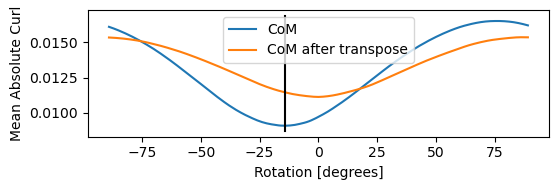

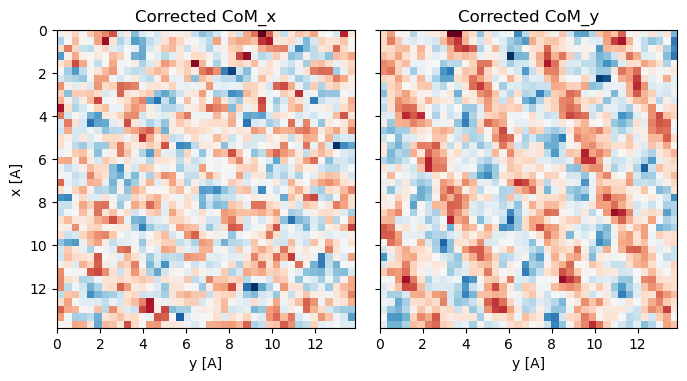

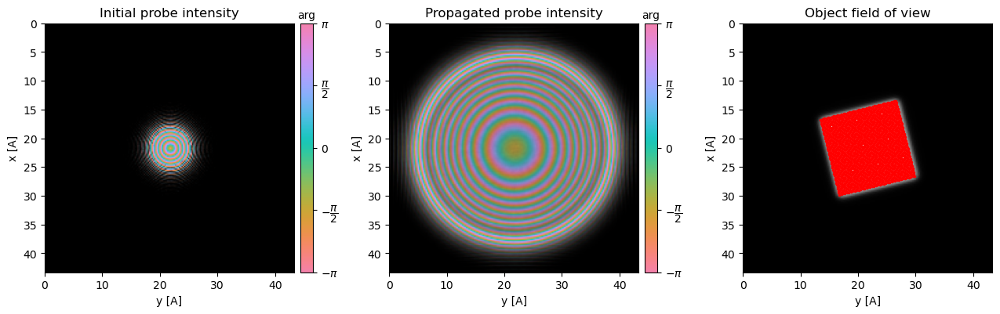

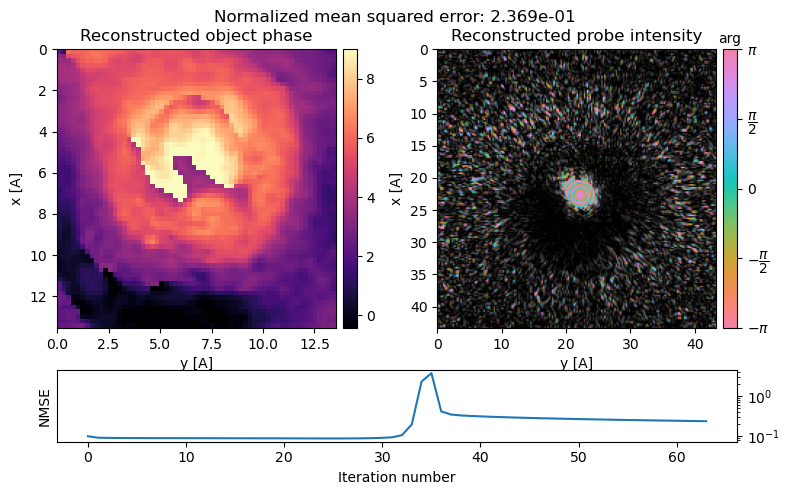

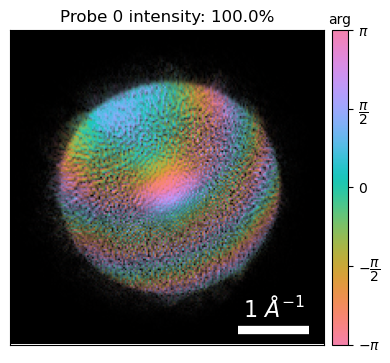

In [12]:


ptycho1 = py4DSTEM.process.phase.MultislicePtychography(
    datacube=dataset,
    energy=300e3,
    defocus=-39,
    vacuum_probe_intensity=probe.data,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
    semiangle_cutoff = 30,
    num_slices=5,
    slice_thicknesses=150,
    object_padding_px = [50,50],
)

ptycho = ptycho1.preprocess(
    plot_rotation=True,
    plot_center_of_mass = True,
    plot_probe_overlaps = True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size= 128, # set max batch size for GPU memory
    clear_fft_cache=True, # clear the FFT cache to free GPU memory
    # force_com_rotation = -1,
)
ptycho00 = ptycho.reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
    fix_probe = False,

).visualize(
)
ptycho.show_fourier_probe()

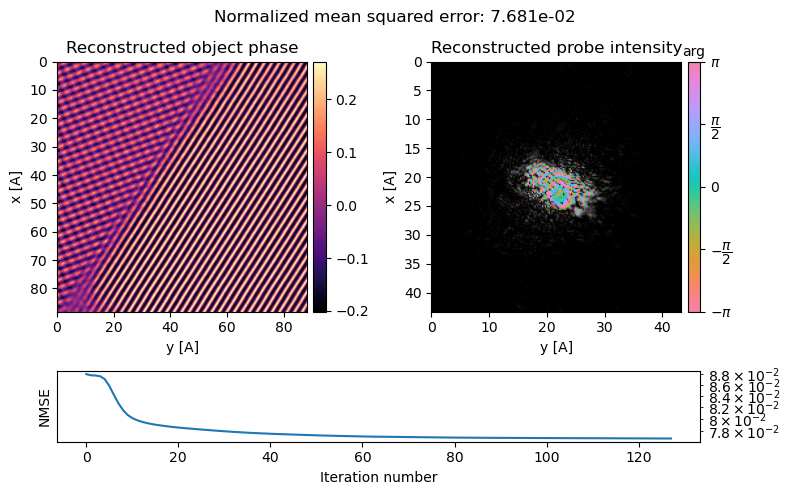

In [ ]:
ptycho00.visualize()
plt.savefig('..\\pictures\\' + 'ptycho00.png', dpi=300)

In [ ]:
import datetime

def now_str():
    return datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")

In [ ]:
now_str()

'2025-06-07_12-17-17'

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3329.53probe position/s]
Best fit rotation = -7 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:08<00:00, 348.49probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 128 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [59:29<00:00, 27.88s/ iter]


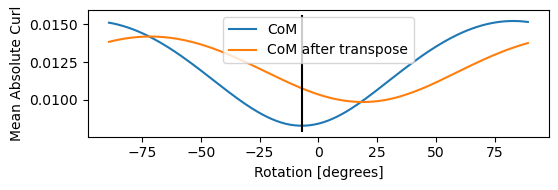

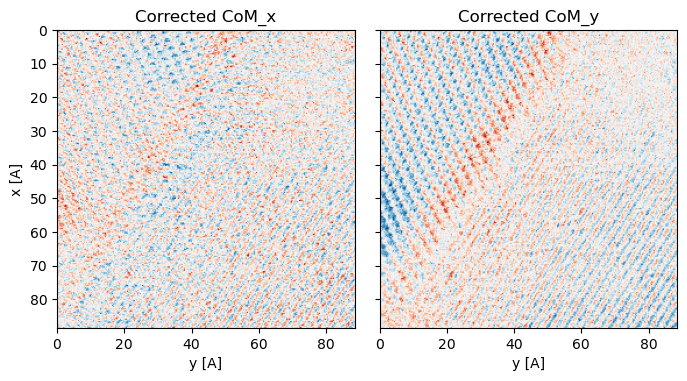

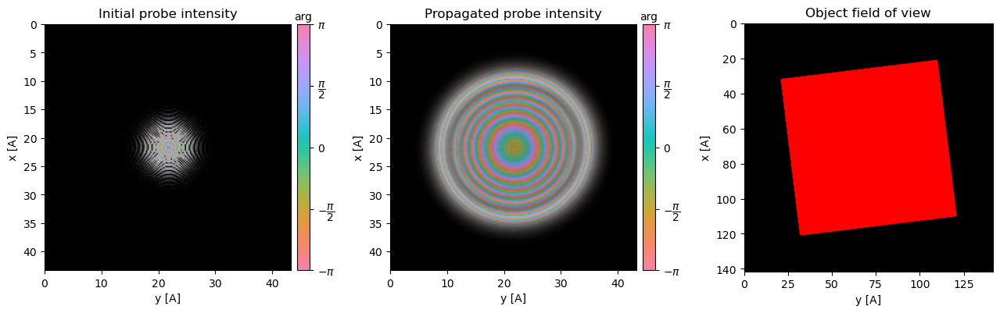

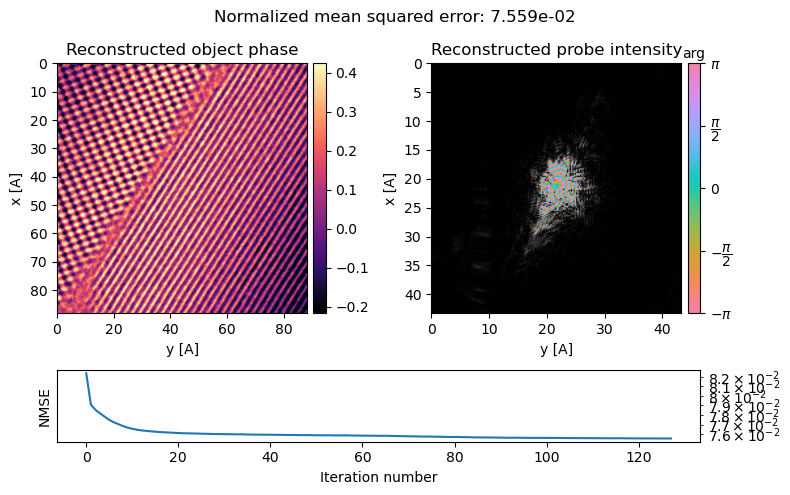

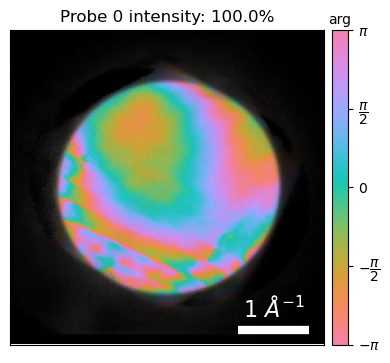

In [ ]:
ptycho1 = py4DSTEM.process.phase.MultislicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=-5,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
    semiangle_cutoff = 30,
    num_slices=6,
    slice_thicknesses=100,
)

ptycho = ptycho1.preprocess(
    plot_rotation=True,
    plot_center_of_mass = True,
    plot_probe_overlaps = True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size= 128, # set max batch size for GPU memory
    clear_fft_cache=True, # clear the FFT cache to free GPU memory
)
ptycho00 = ptycho.reconstruct(
    num_iter = 128,
    seed_random=0,
    max_batch_size=128,
    fix_probe = False,

).visualize(
)
plt.savefig('..\\pictures\\' +now_str()+ 'ptycho00_multislice.png', dpi=300)
ptycho.show_fourier_probe()
plt.savefig('..\\pictures\\' +now_str()+ 'ptycho00_multislice_fourier_probe.png', dpi=300)

# ptychos_sweep_roll.append(ptycho00)

# ptychos_object.append( np.angle(ptycho00.object_cropped).copy())
# ptychos_object_fft.append(ptycho00.object_fft)

Continuing reconstruction from previous result. Use reset=True for a fresh start.
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 256 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [47:21<00:00, 22.20s/ iter]


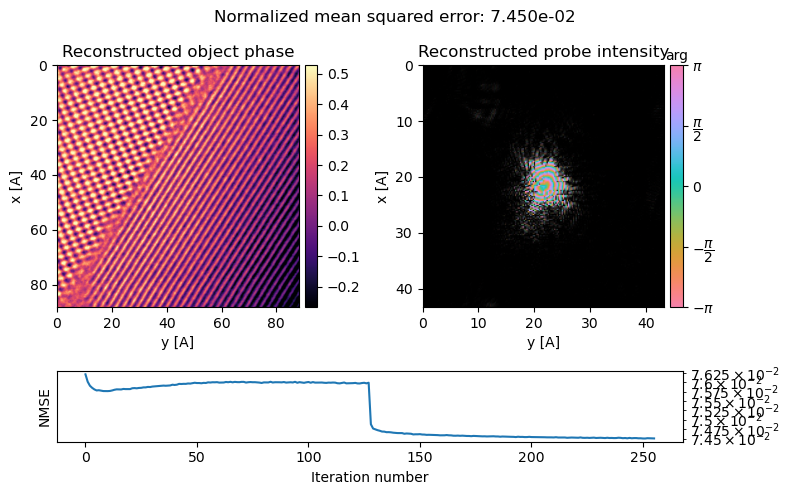

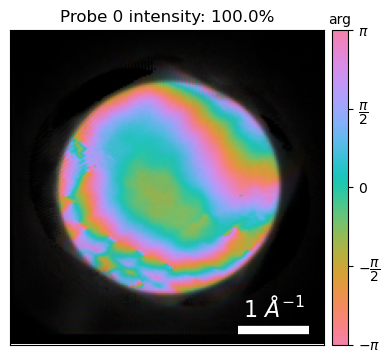

In [ ]:
ptycho00 = ptycho.reconstruct(
    num_iter = 128,
    seed_random=0,
    max_batch_size=256,
    fix_probe = False,

).visualize(
)
plt.savefig('..\\pictures\\' +now_str()+ 'ptycho00_multislice.png', dpi=300)
ptycho.show_fourier_probe()
plt.savefig('..\\pictures\\' +now_str()+ 'ptycho00_multislice_fourier_probe.png', dpi=300)


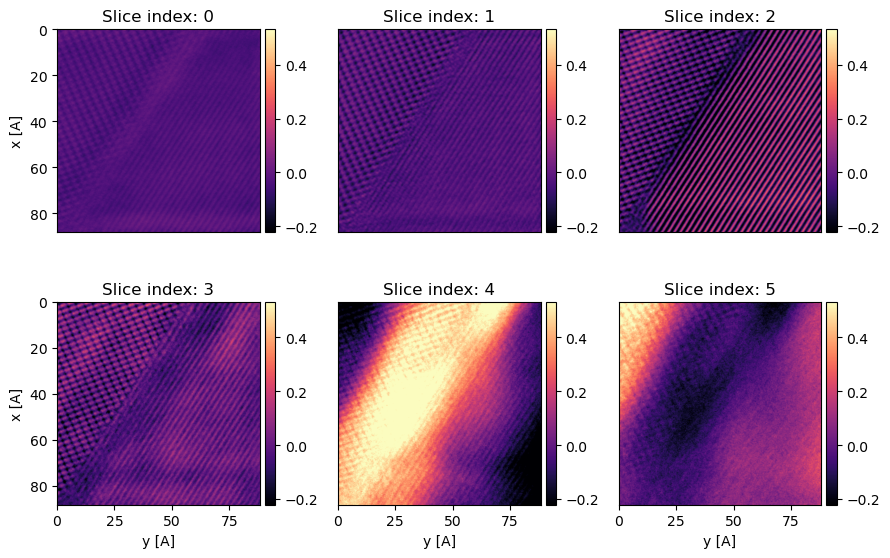

In [ ]:
ptycho00.show_slices()

In [ ]:
ptycho00.

AttributeError: 'MultislicePtychography' object has no attribute 'get_slices'

Continuing reconstruction from previous result. Use reset=True for a fresh start.
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [02:28<00:00,  1.16s/ iter]


IndexError: index 0 is out of bounds for axis 0 with size 0

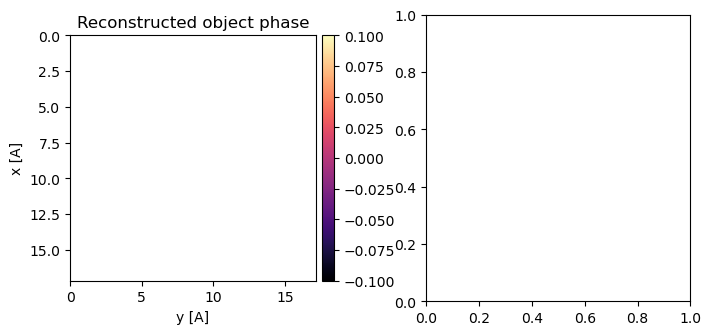

In [ ]:
ptycho00 = ptycho.reconstruct(
    num_iter = 128,
    seed_random=0,
    max_batch_size=512,
    fix_probe = False,

).visualize(
)

In [ ]:
image = np.angle(ptycho00.object_cropped).copy()
image = image[:]

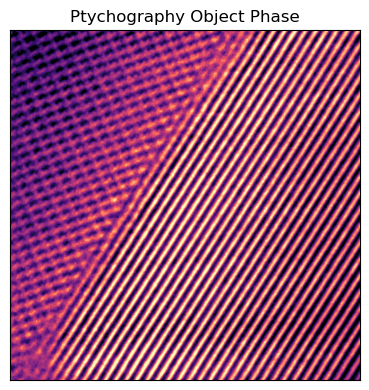

In [ ]:
py4DSTEM.show(
    np.mean(image, axis = 0),
    cmap='magma',
    figsize=(4,4),
    ticks=False,
    title='Ptychography Object Phase',
)

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 349.34probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [00:16<00:00,  3.84 iter/s]
Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 350.88probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [00:16<00:00,  3.87 iter/s]
Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 352.15probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and

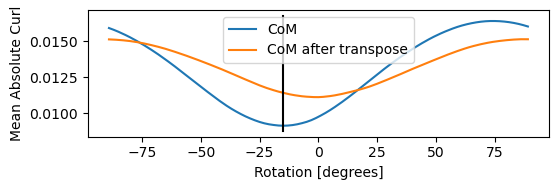

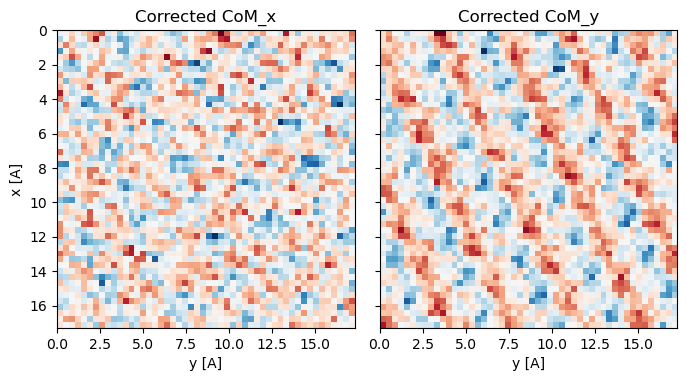

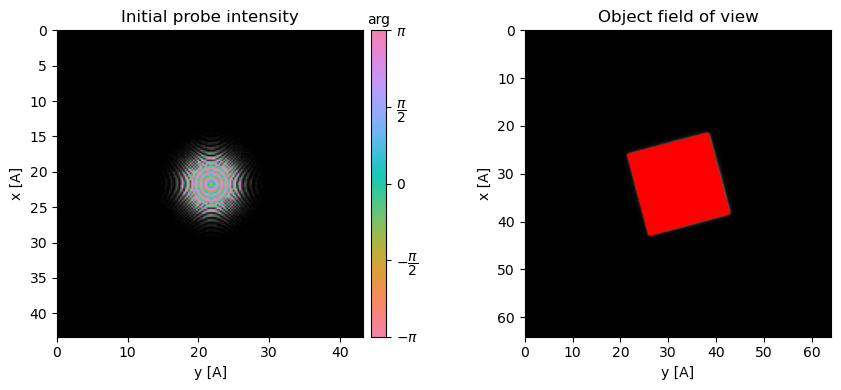

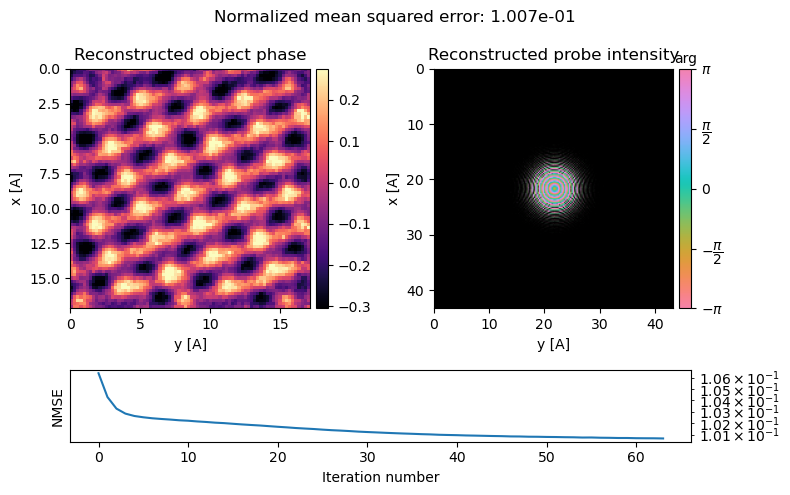

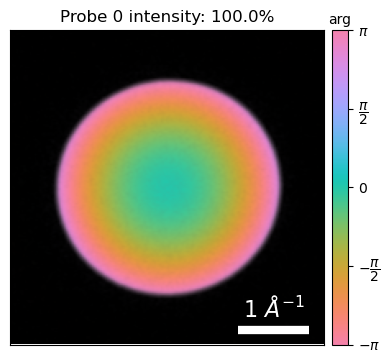

...

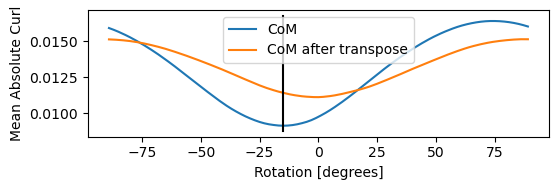

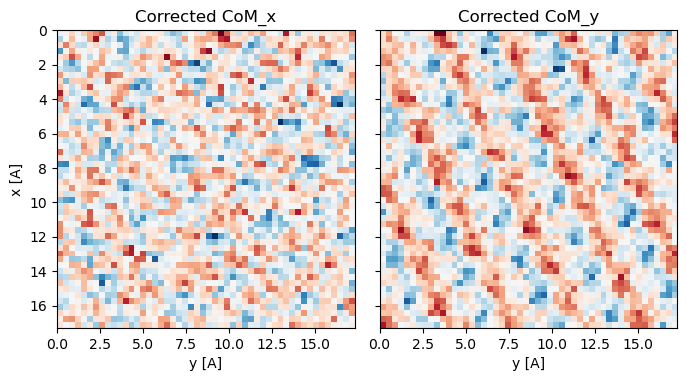

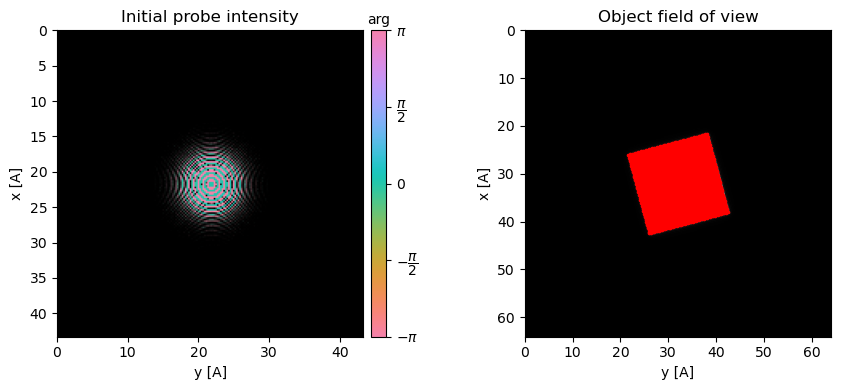

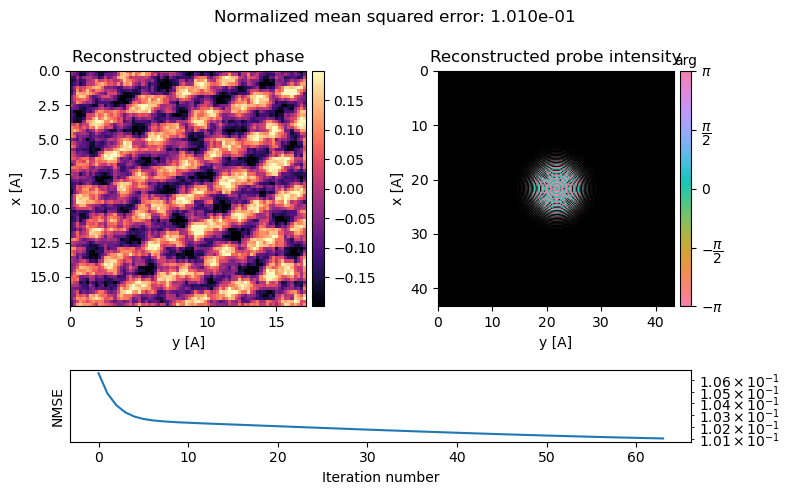

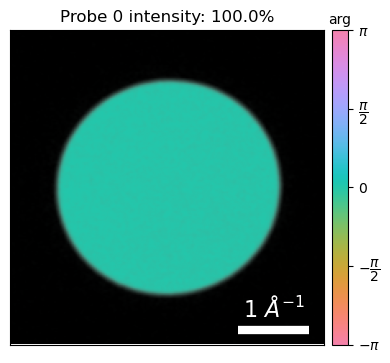

In [ ]:
ptychos_sweep_roll = []
ptychos_object = []
ptychos_object_fft = []

sweep_param = np.linspace(-25,0,5)

for roll in sweep_param:
    ptycho1 = py4DSTEM.process.phase.SingleslicePtychography(
        datacube=datacube_partial,
        energy=300e3,
        defocus=roll,
        vacuum_probe_intensity=probe_nparray,
        verbose=True,
        device='gpu', # uncomment if you have access to a GPU
        storage='cpu', # uncomment if you have access to a GPU
        semiangle_cutoff = 30,
    )

    ptycho = ptycho1.preprocess(
        plot_rotation=True,
        plot_center_of_mass = True,
        plot_probe_overlaps = True,
        # vectorized_com_calculation = False, # disable default CoM vectorized calc
        # store_initial_arrays= False, # don't store arrays necessary for reset=True
        max_batch_size= 128, # set max batch size for GPU memory
        clear_fft_cache=True, # clear the FFT cache to free GPU memory
    )
    ptycho00 = ptycho.reconstruct(
        num_iter = 64,
        seed_random=0,
        max_batch_size=512,
        fix_probe = True,
    ).visualize(
    )
    ptycho.show_fourier_probe()

    ptychos_sweep_roll.append(ptycho00)

    ptychos_object.append( np.angle(ptycho00.object_cropped).copy())
    ptychos_object_fft.append(ptycho00.object_fft)

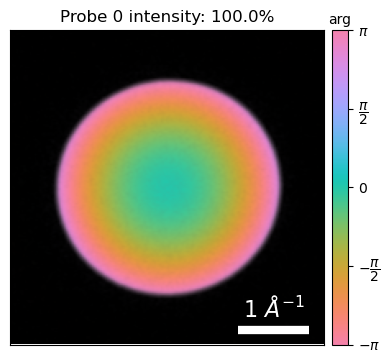

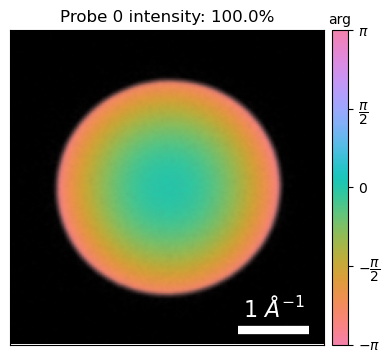

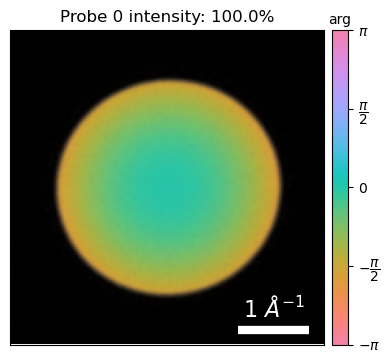

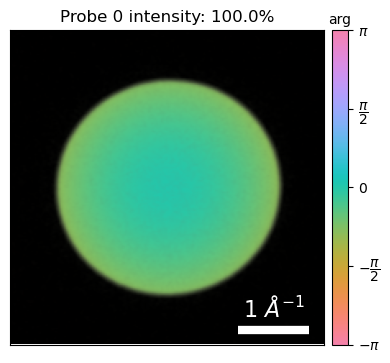

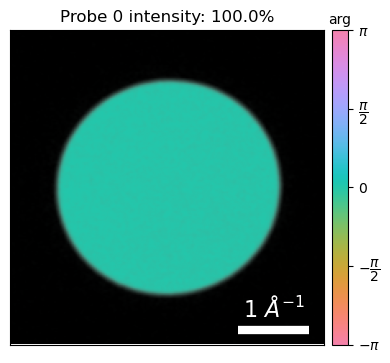

In [ ]:
probe_intensities = []
probe_images = []
for i, p in enumerate(ptychos_sweep_roll):
    probe_intensity = np.abs(p.probe.copy())
    probe_intensities.append(probe_intensity)

    p.show_fourier_probe()
    plt.savefig(f'test_probe{i}.png', dpi=300, bbox_inches='tight')

    probe_images.append(plt.imread(f'test_probe{i}.png'))

    # py4DSTEM.show(
    #     probe_intensity
    # )

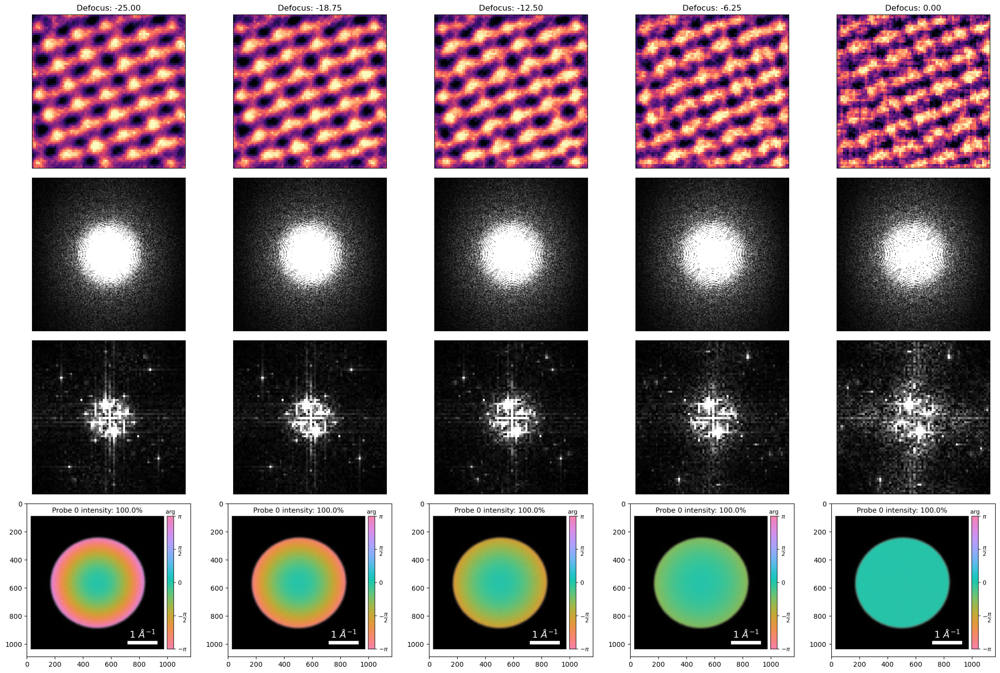

In [ ]:
fig, axs = plt.subplots(4,len(ptychos_object),figsize=(3.5*6,3.5*4))
sweep_param_name = 'Defocus'

titles = []
for i, roll in enumerate(sweep_param):
    titles.append(f"{sweep_param_name}: {roll:.2f}")

py4DSTEM.show(
    ptychos_object,
    ticks=False,
    figax=(fig,axs[0]),
    cmap='magma',
    title=titles,
)

py4DSTEM.show(
    probe_intensities,
    ticks=False,
    figax=(fig,axs[1]),
    vmin=0.001,
    vmax=0.899,
)
py4DSTEM.show(
    ptychos_object_fft,
    ticks=False,
    figax=(fig,axs[2]),
)

for i, ax in enumerate(axs[3]):
    ax.imshow(probe_images[i])

fig.tight_layout()
fig.savefig(f'C:\\github\\py4DSTEM_tutorials\\pictures\\ptycho_sweep_{sweep_param_name}_fine2_big_area_fix_probe_2.png', dpi=300, bbox_inches='tight')

In [ ]:
ptycho00 = ptycho.reconstruct(
        num_iter = 64,
        seed_random=0,
        max_batch_size=512,
    )

Continuing reconstruction from previous result. Use reset=True for a fresh start.
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [01:01<00:00,  1.04 iter/s]


Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 350.85probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:24<00:00,  1.51 iter/s]


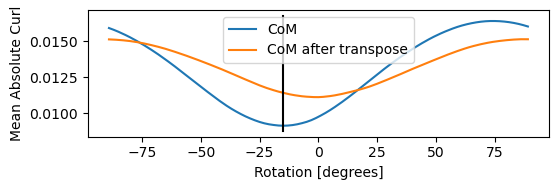

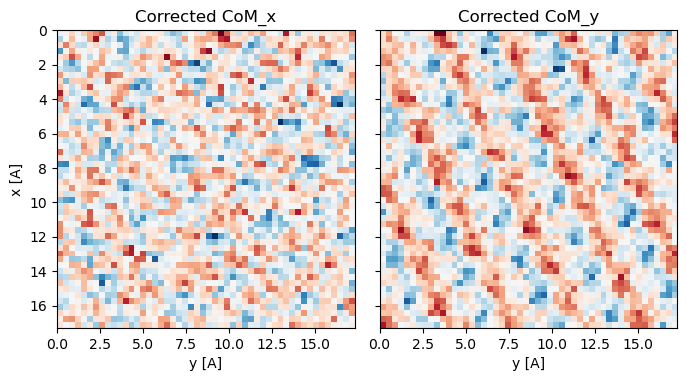

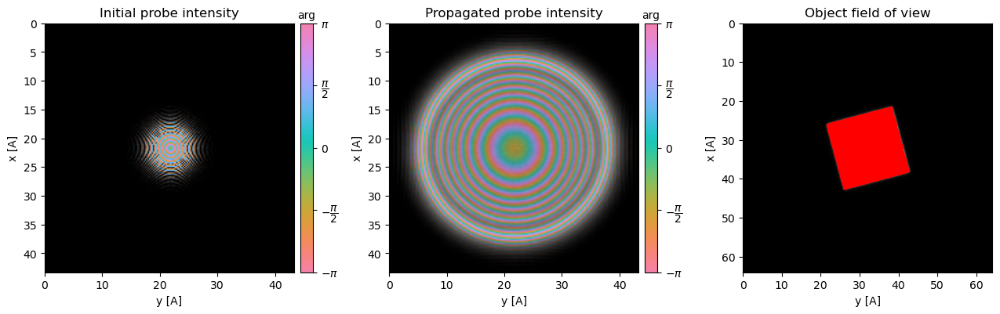

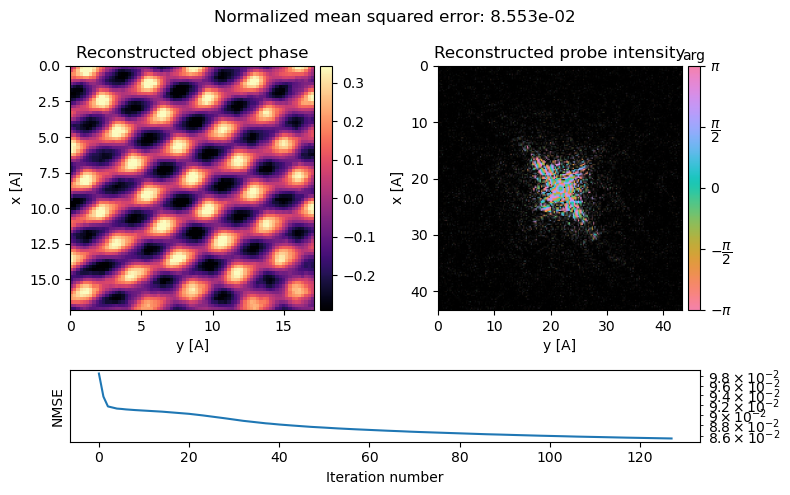

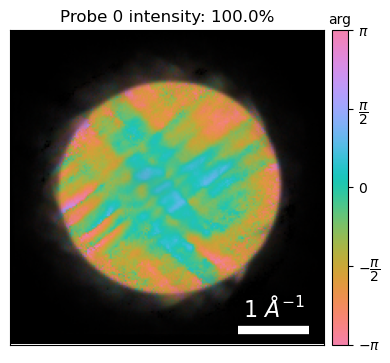

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 351.65probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:24<00:00,  1.52 iter/s]


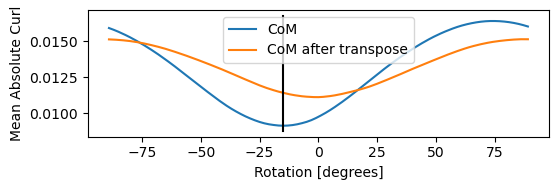

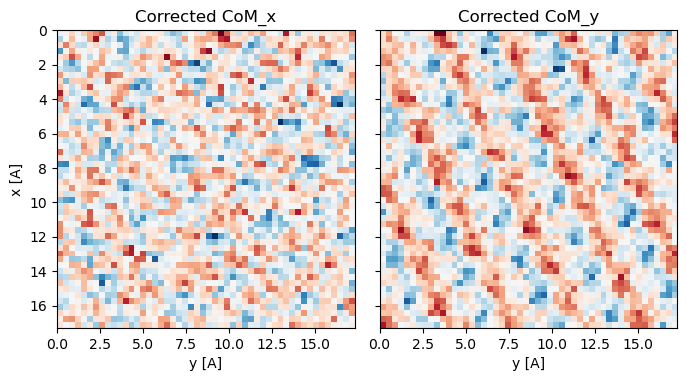

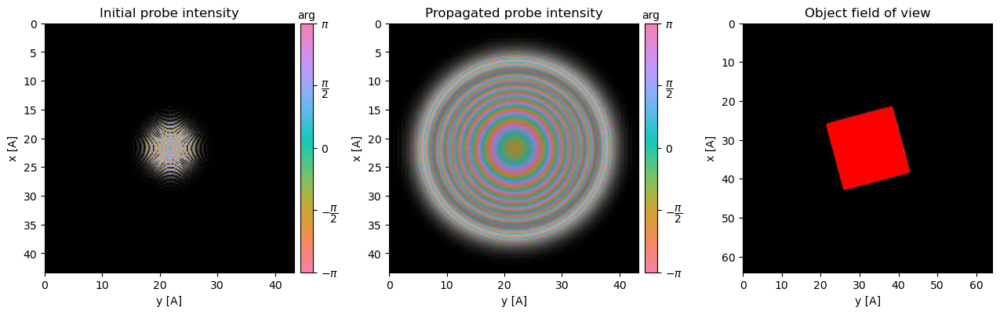

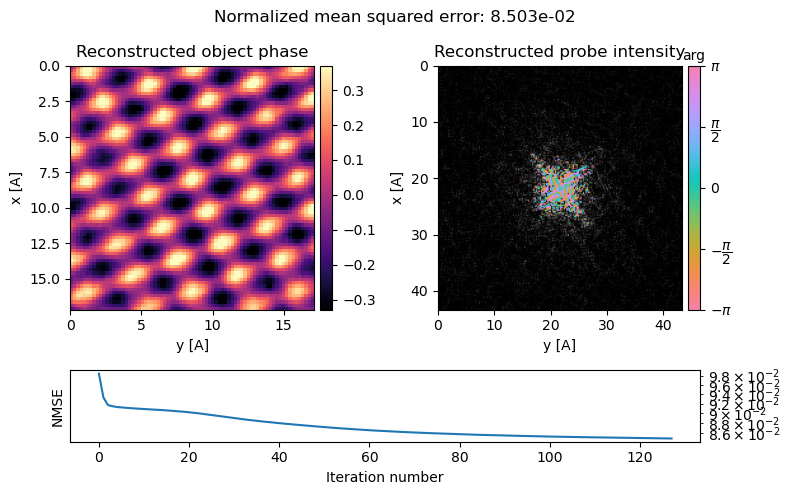

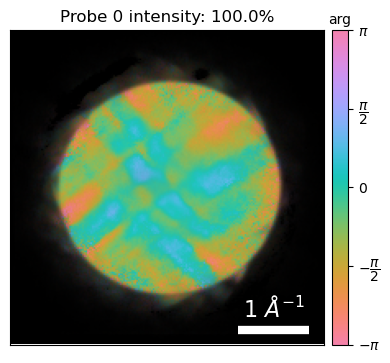

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 348.35probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:22<00:00,  1.54 iter/s]


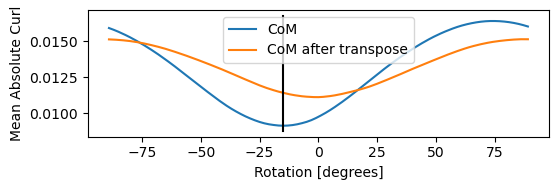

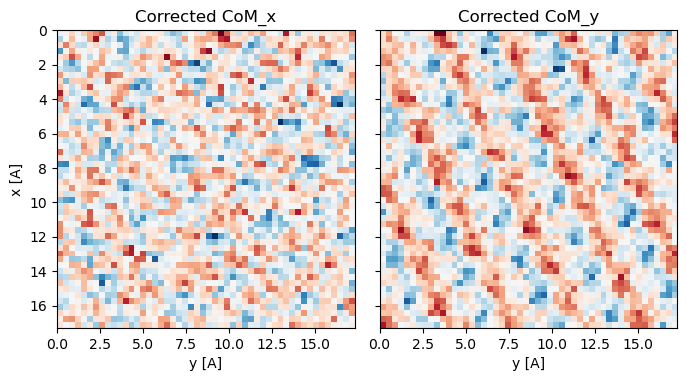

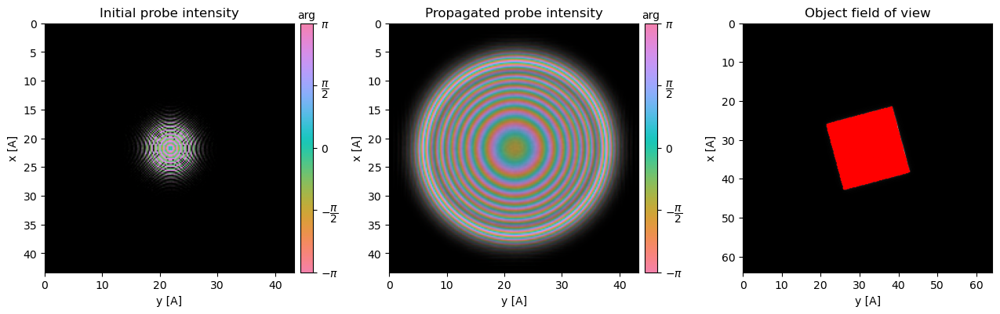

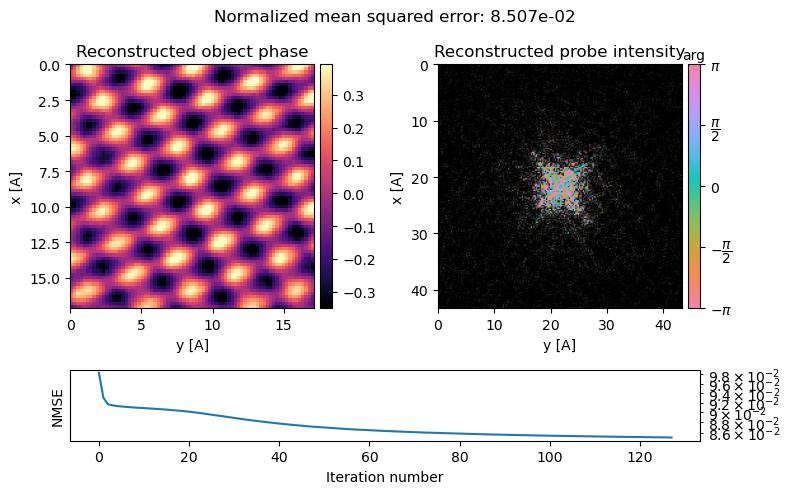

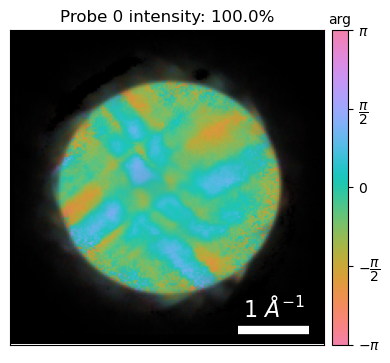

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 346.49probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:22<00:00,  1.54 iter/s]


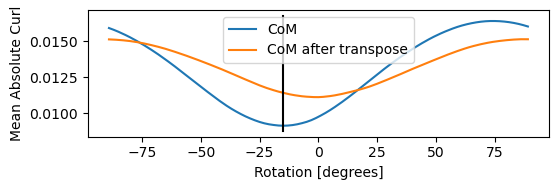

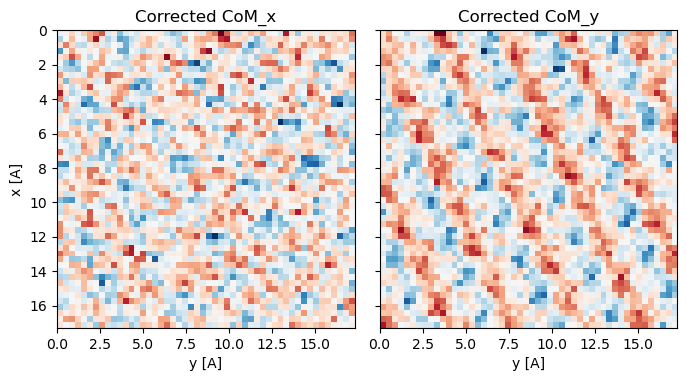

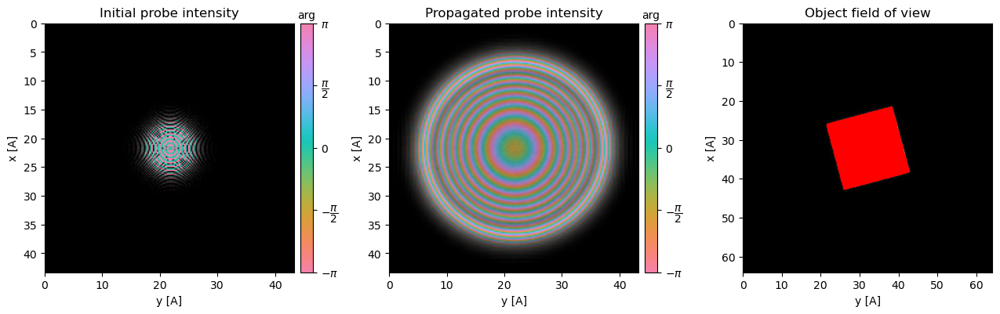

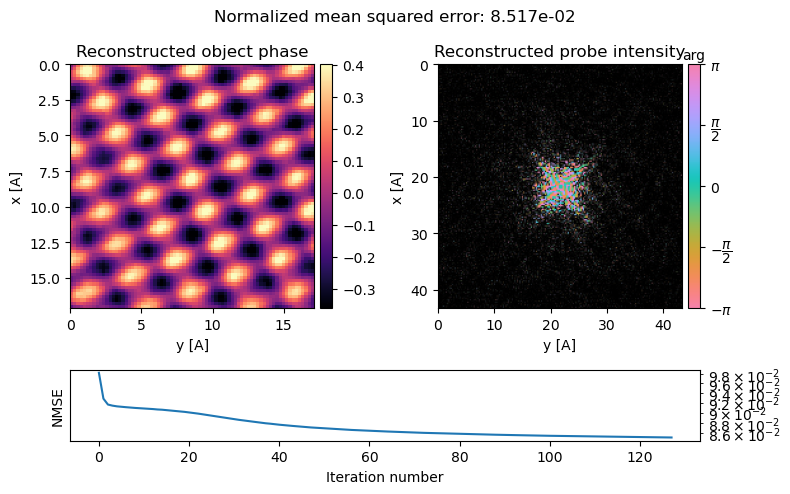

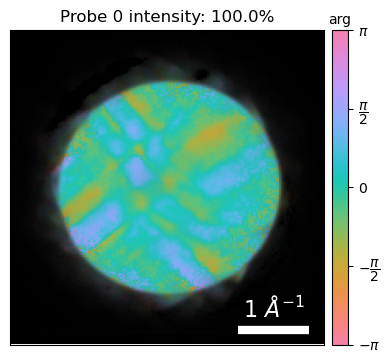

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 347.87probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:23<00:00,  1.54 iter/s]


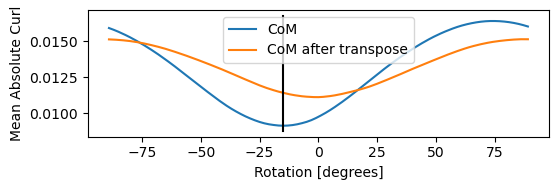

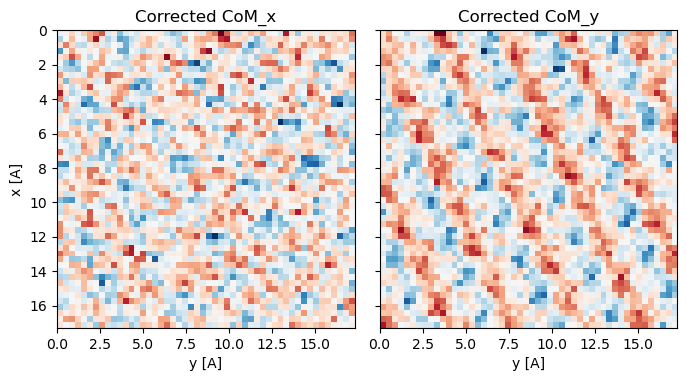

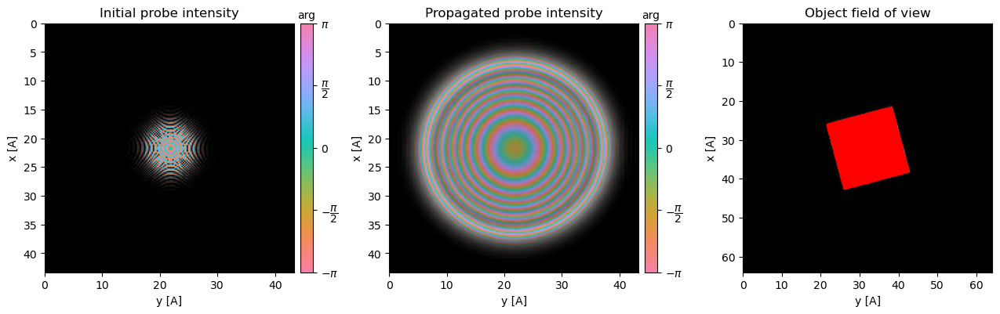

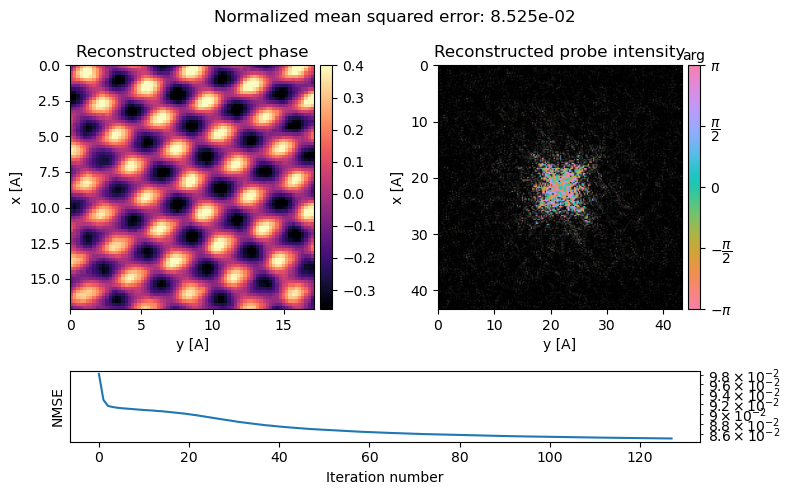

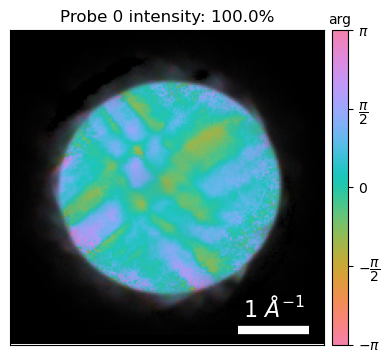

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 349.23probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:23<00:00,  1.54 iter/s]


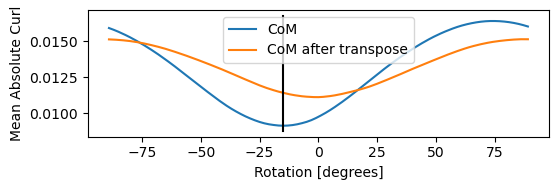

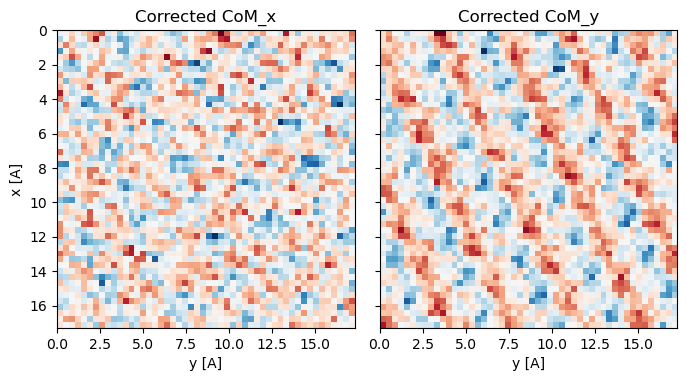

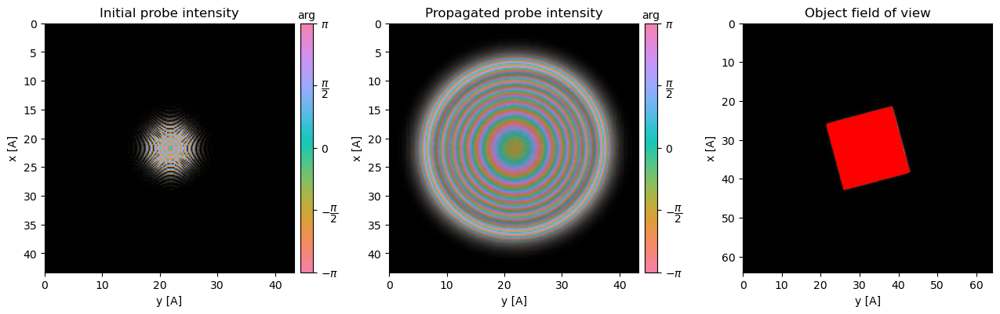

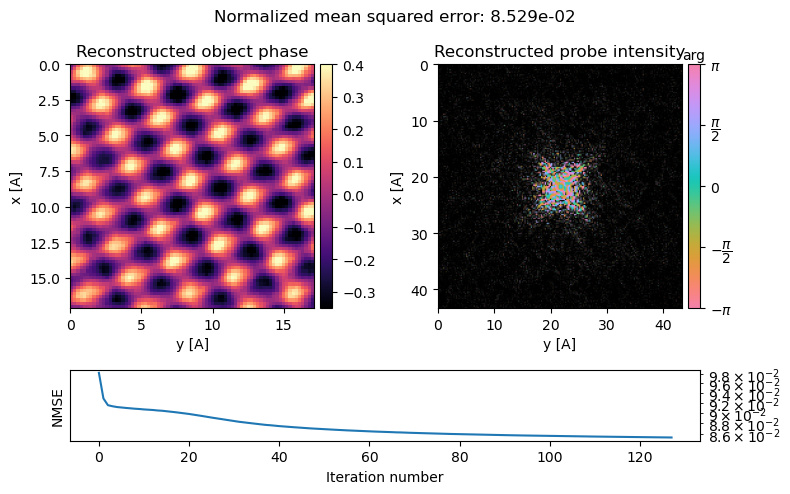

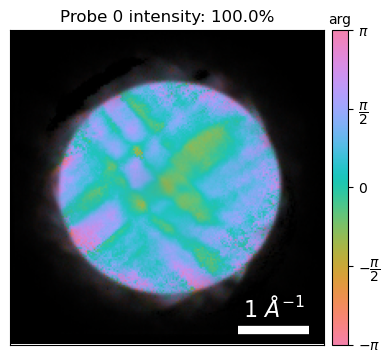

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 347.42probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:23<00:00,  1.54 iter/s]


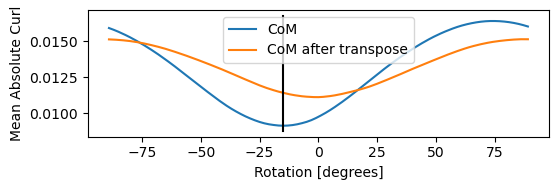

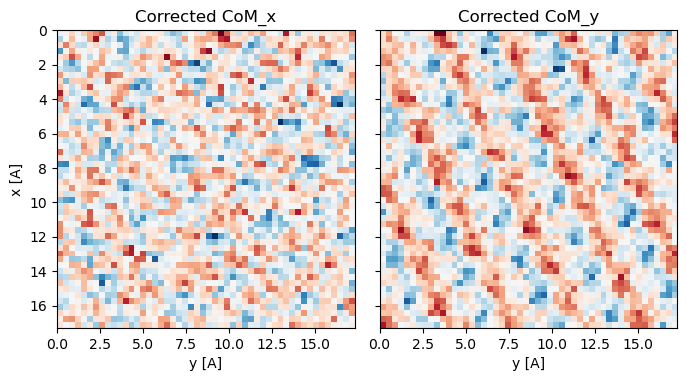

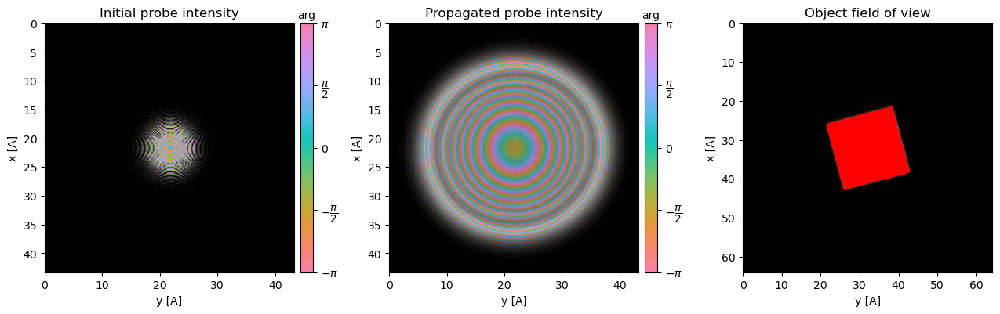

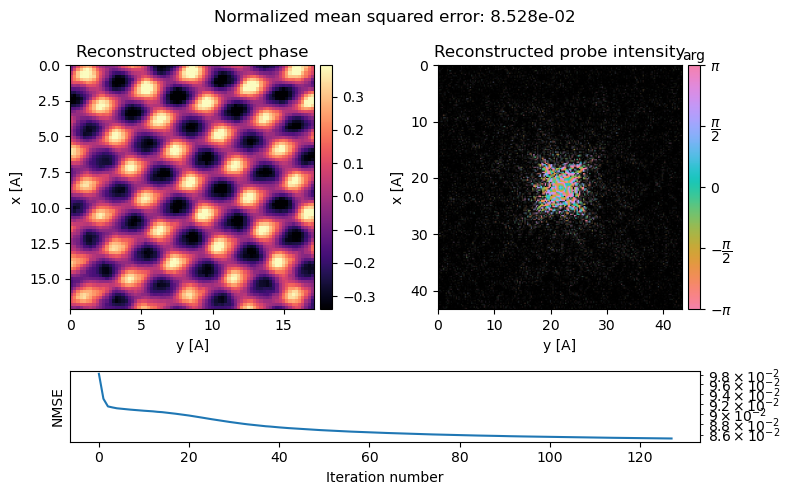

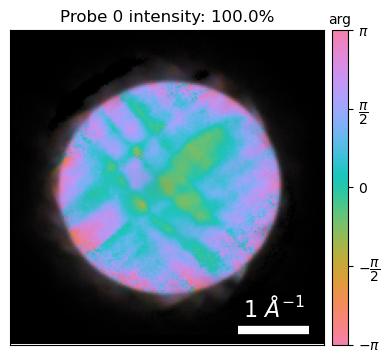

In [ ]:
ptychos_sweep_roll = []
ptychos_object = []
ptychos_object_fft = []

sweep_param = np.linspace(-15,15,7)
tot_thickness = 750

for roll in sweep_param:    
    ptycho1 = py4DSTEM.process.phase.MultislicePtychography(
        datacube=datacube_partial,
        energy=300e3,
        defocus=roll,
        vacuum_probe_intensity=probe_nparray,
        verbose=True,
        device='gpu', # uncomment if you have access to a GPU
        storage='cpu', # uncomment if you have access to a GPU
        semiangle_cutoff = 30,
        num_slices=5,
        slice_thicknesses=150,
    )

    ptycho = ptycho1.preprocess(
        plot_rotation=True,
        plot_center_of_mass = True,
        plot_probe_overlaps = True,
        # vectorized_com_calculation = False, # disable default CoM vectorized calc
        # store_initial_arrays= False, # don't store arrays necessary for reset=True
        max_batch_size= 128, # set max batch size for GPU memory
        clear_fft_cache=True, # clear the FFT cache to free GPU memory
    )
    ptycho00 = ptycho.reconstruct(
        num_iter = 128,
        seed_random=0,
        max_batch_size=512,
        fix_probe = False,

    ).visualize(
    )
    ptycho.show_fourier_probe()

    ptychos_sweep_roll.append(ptycho00)

    ptychos_object.append(np.average(np.angle(ptycho00.object_cropped).copy(), axis = 0))
    ptychos_object_fft.append(ptycho00.object_fft)
    plt.show()

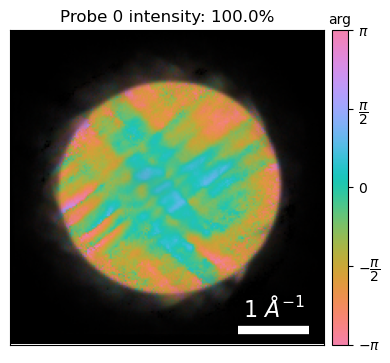

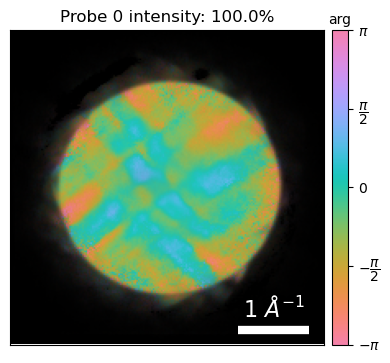

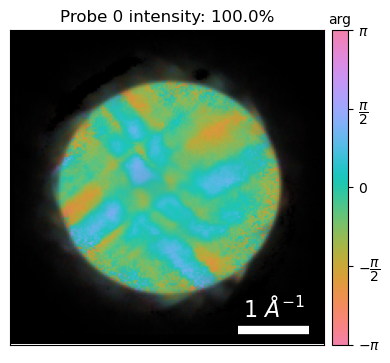

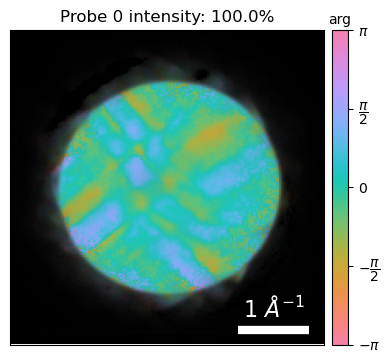

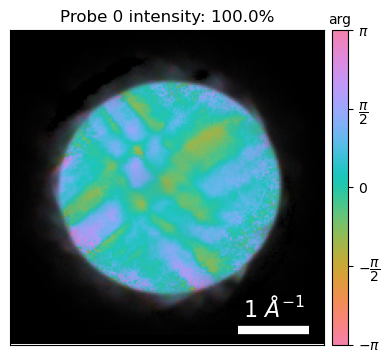

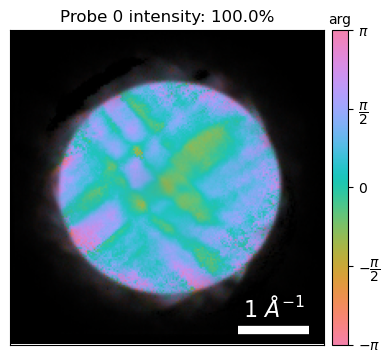

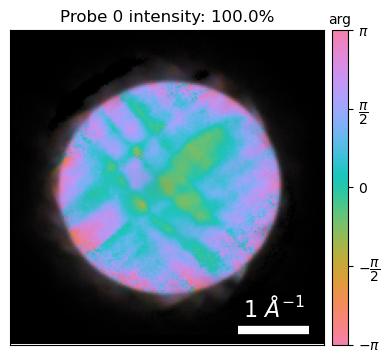

In [ ]:
probe_intensities = []
probe_images = []
for i, p in enumerate(ptychos_sweep_roll):
    probe_intensity = np.abs(p.probe.copy())
    probe_intensities.append(probe_intensity)

    p.show_fourier_probe()
    plt.savefig(f'test_probe{i}.png', dpi=300, bbox_inches='tight')

    probe_images.append(plt.imread(f'test_probe{i}.png'))

    # py4DSTEM.show(
    #     probe_intensity
    # )

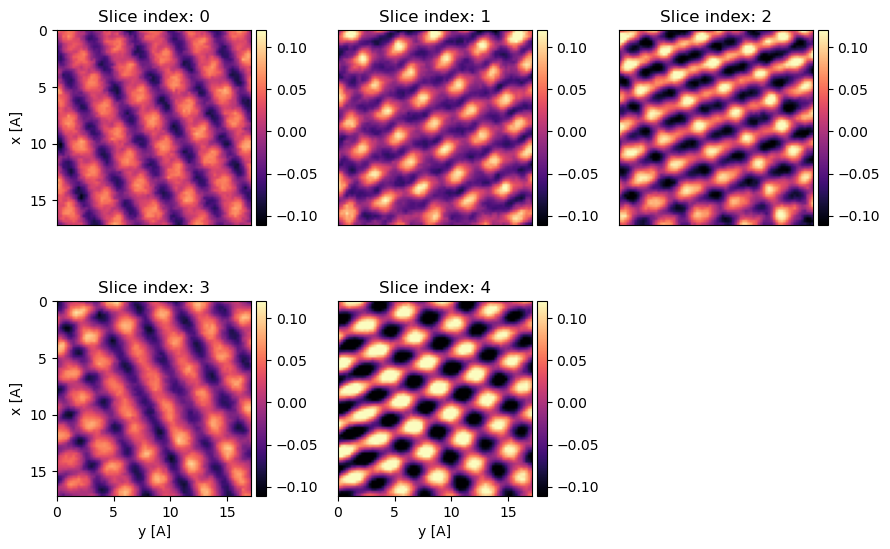

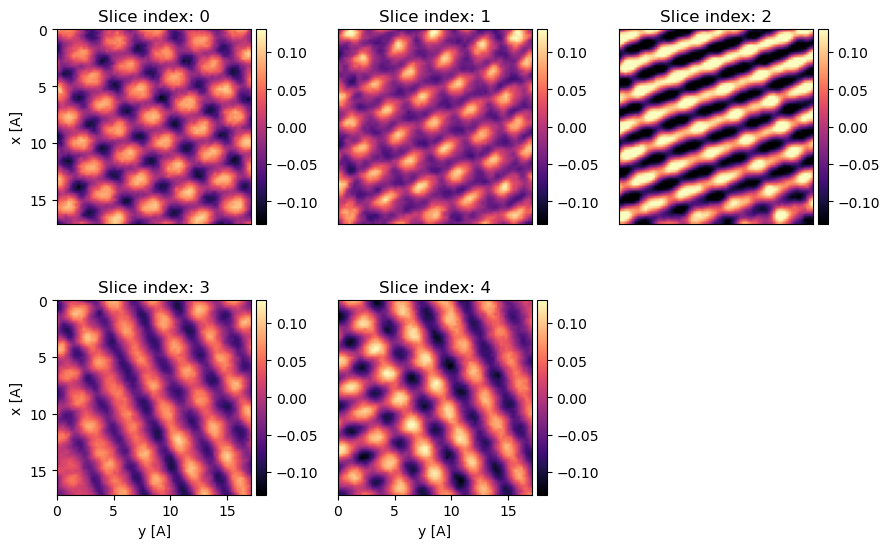

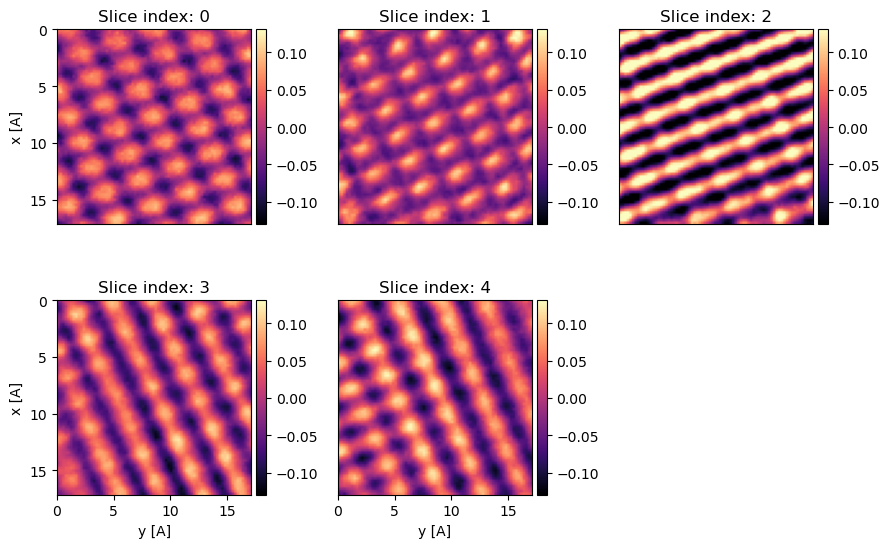

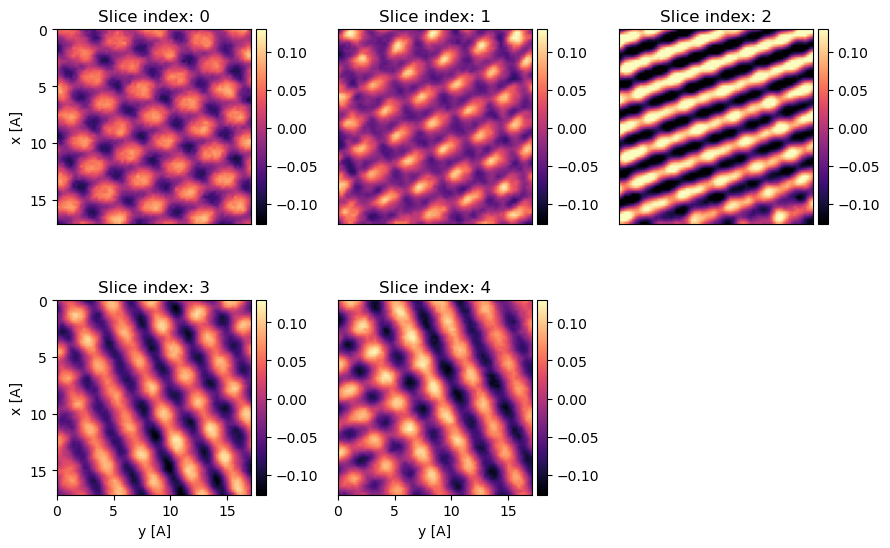

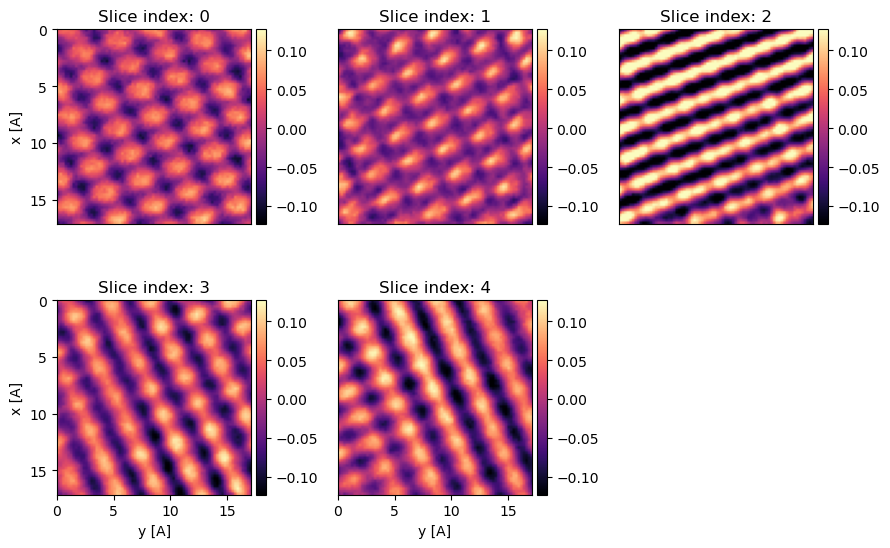

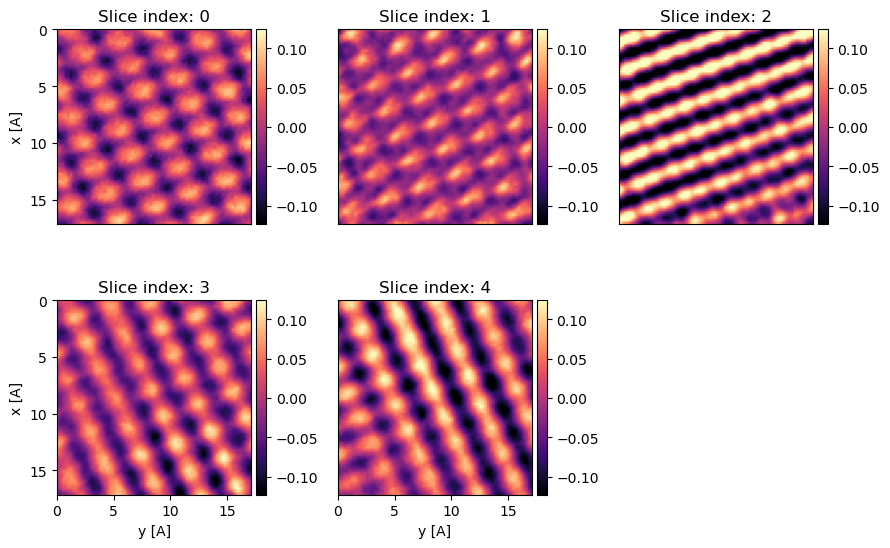

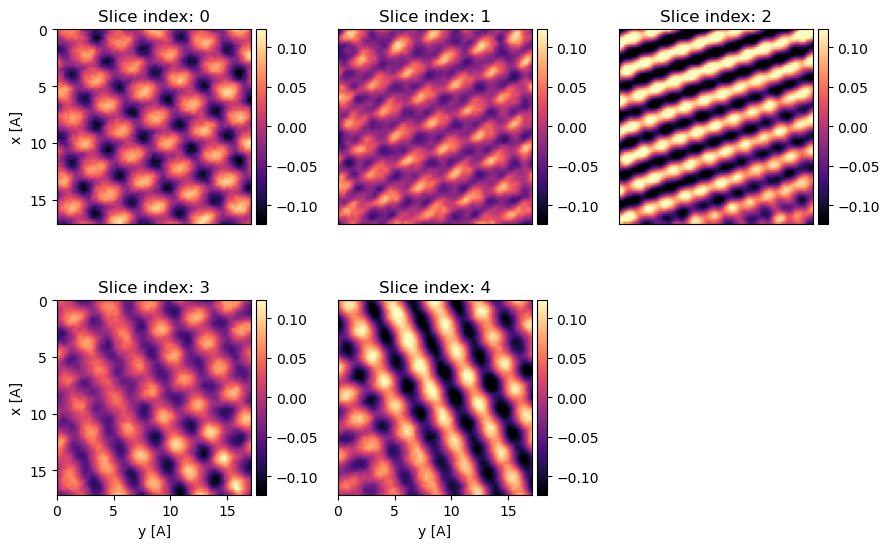

In [ ]:
for i,p in enumerate(ptychos_sweep_roll):
    p.show_slices()
    plt.savefig(f'test_5x150nm_multislice_{sweep_param[i]:.2f}nm_bigger_area.png', dpi=300, bbox_inches='tight')

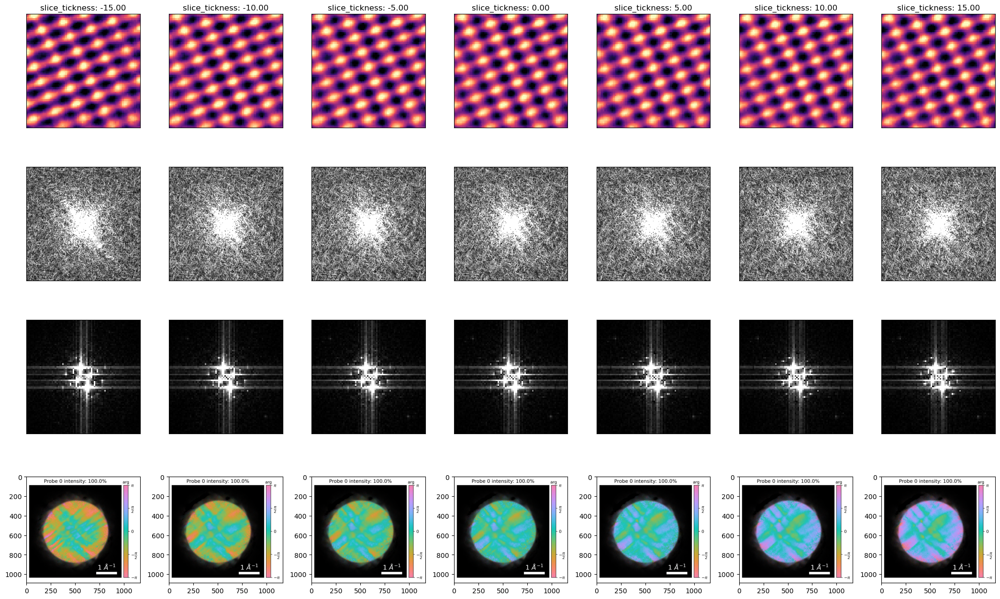

In [ ]:
fig, axs = plt.subplots(4,len(ptychos_object),figsize=(3.5*6,3.5*4))
sweep_param_name = 'slice_tickness'

titles = []
for i, roll in enumerate(sweep_param):
    titles.append(f"{sweep_param_name}: {roll:.2f}")

py4DSTEM.show(
    ptychos_object,
    ticks=False,
    figax=(fig,axs[0]),
    cmap='magma',
    title=titles,
)

py4DSTEM.show(
    probe_intensities,
    ticks=False,
    figax=(fig,axs[1]),
    vmin=0.001,
    vmax=0.899,
)
py4DSTEM.show(
    ptychos_object_fft,
    ticks=False,
    figax=(fig,axs[2]),
)

for i, ax in enumerate(axs[3]):
    ax.imshow(probe_images[i])

fig.tight_layout()
fig.savefig(f'C:\\github\\py4DSTEM_tutorials\\pictures\\ptycho_sweep_5x150nm_{sweep_param_name}_bigger_area.png', dpi=300, bbox_inches='tight')

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 351.05probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 1 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [2:40:03<00:00, 75.03s/ iter] 


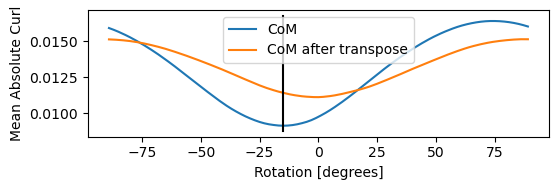

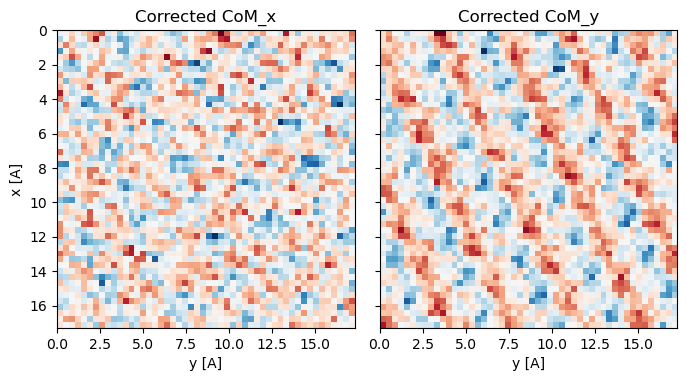

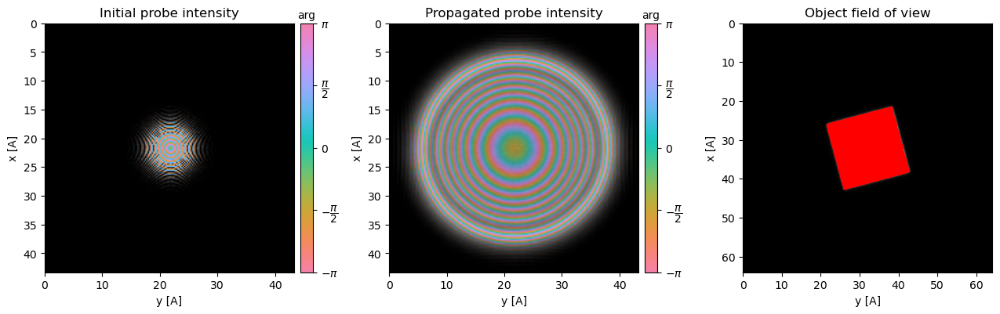

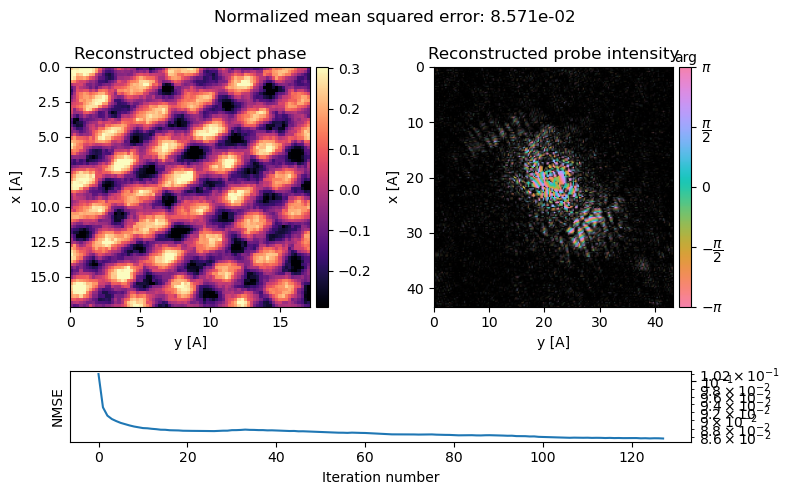

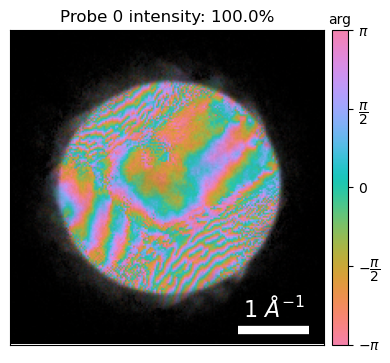

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 348.01probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 4 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [37:54<00:00, 17.77s/ iter]


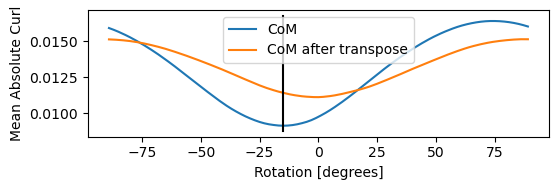

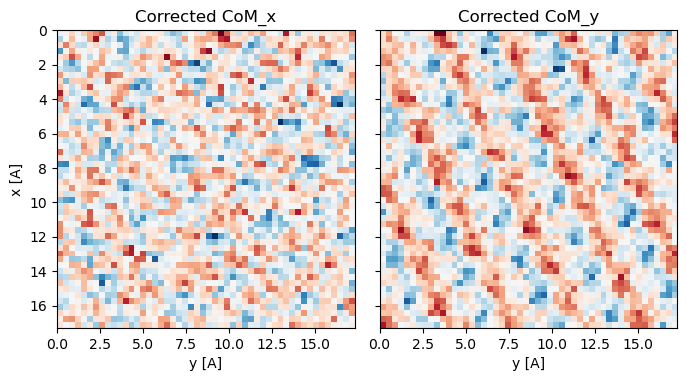

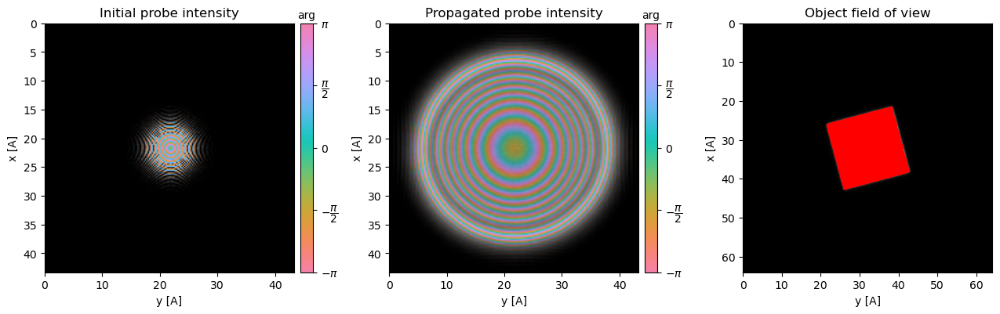

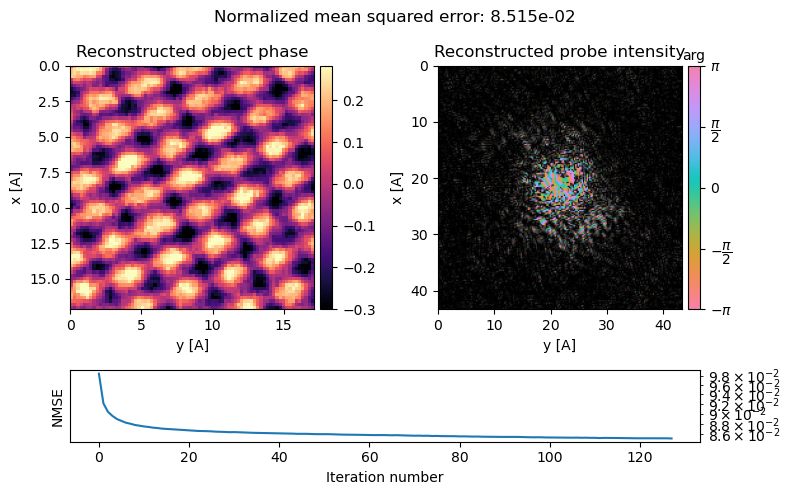

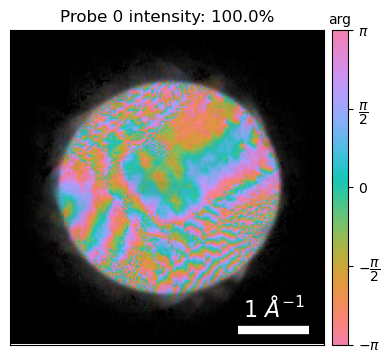

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 349.63probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 16 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [09:58<00:00,  4.68s/ iter]


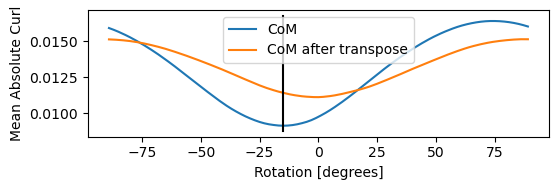

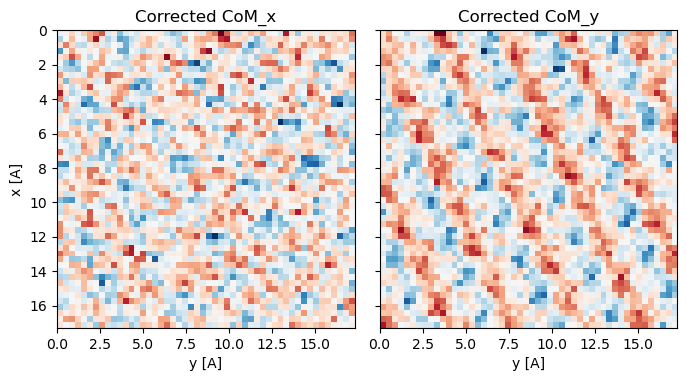

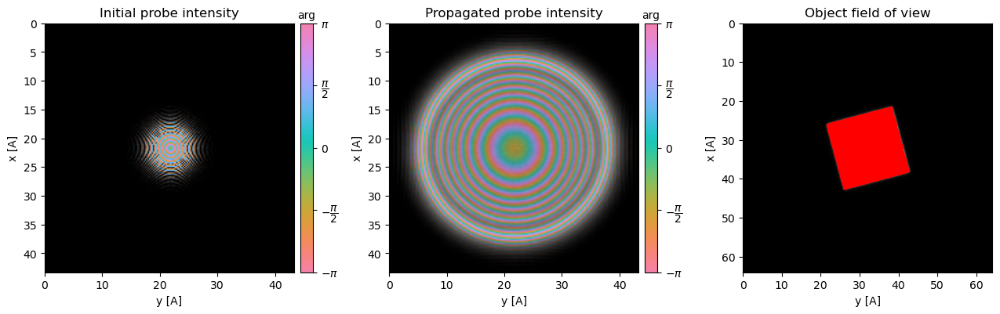

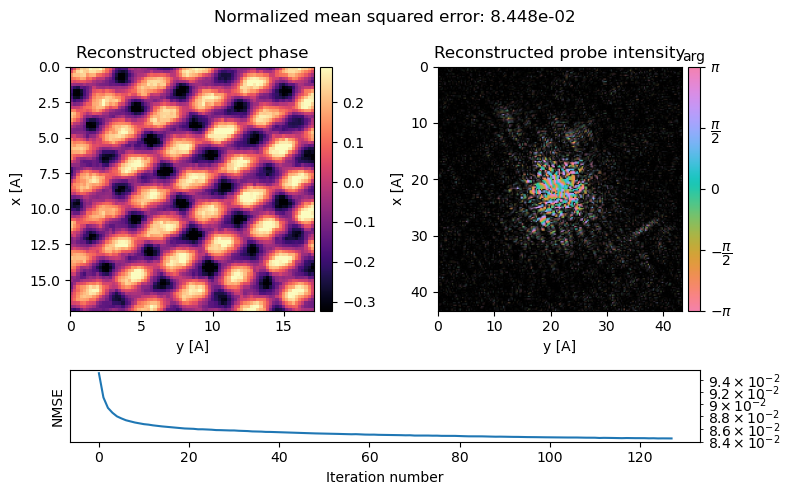

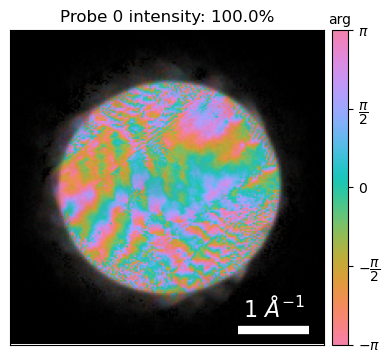

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 349.80probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 64 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [02:52<00:00,  1.35s/ iter]


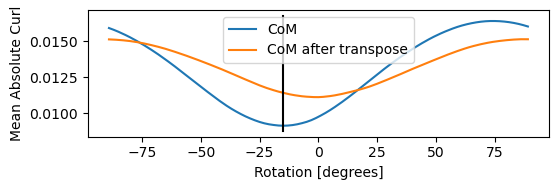

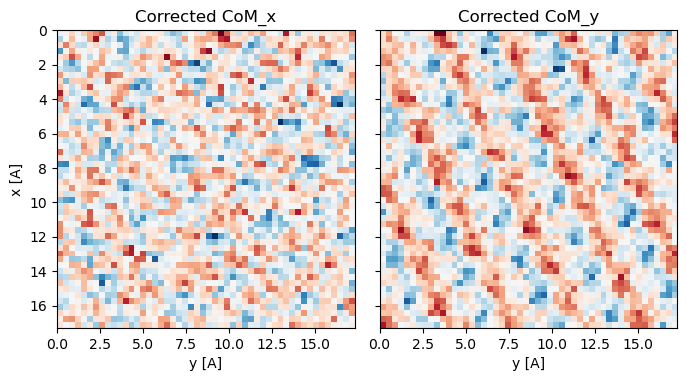

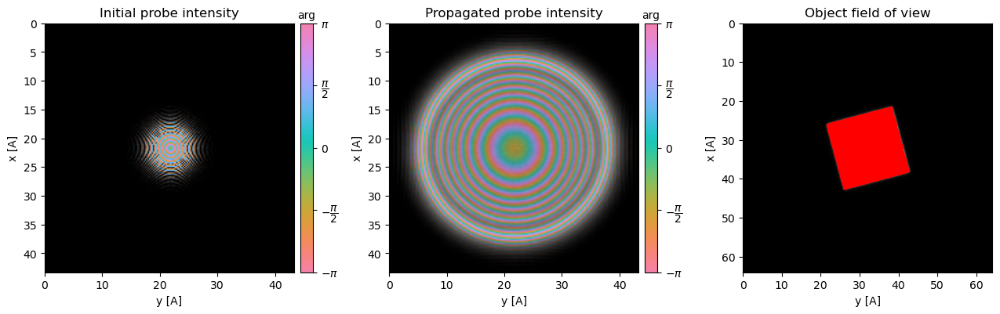

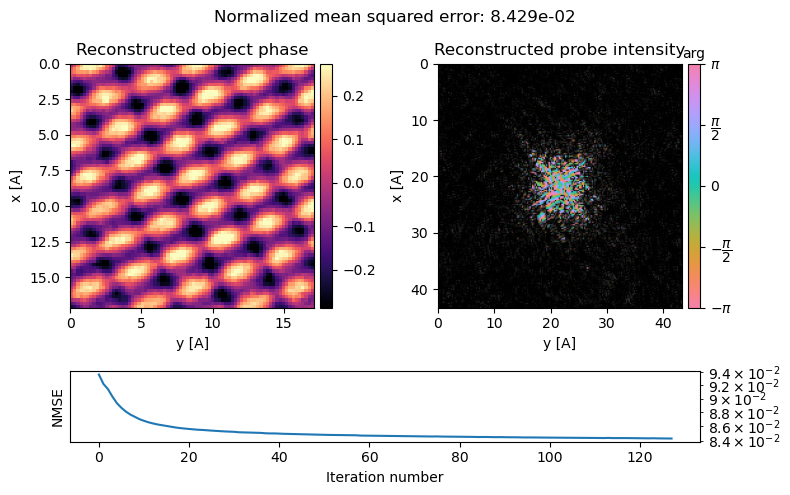

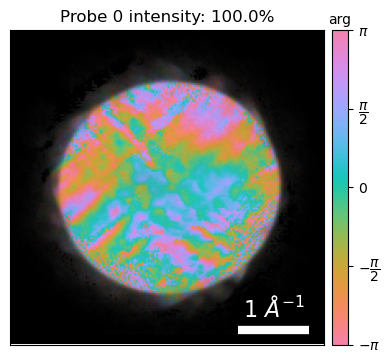

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 349.11probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 256 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:33<00:00,  1.36 iter/s]


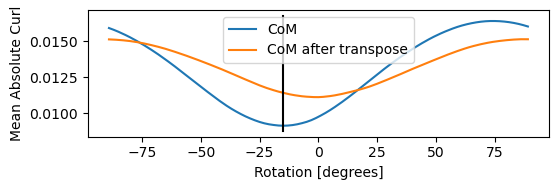

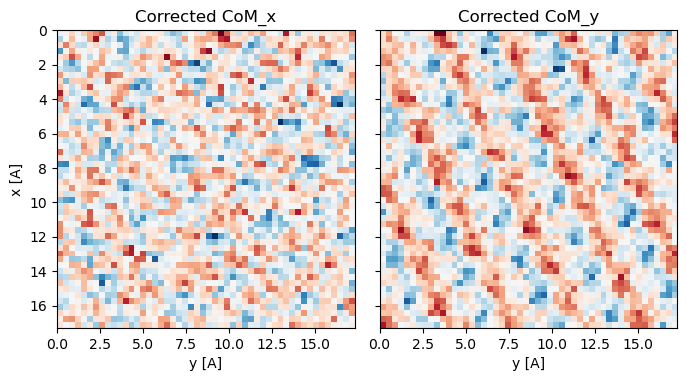

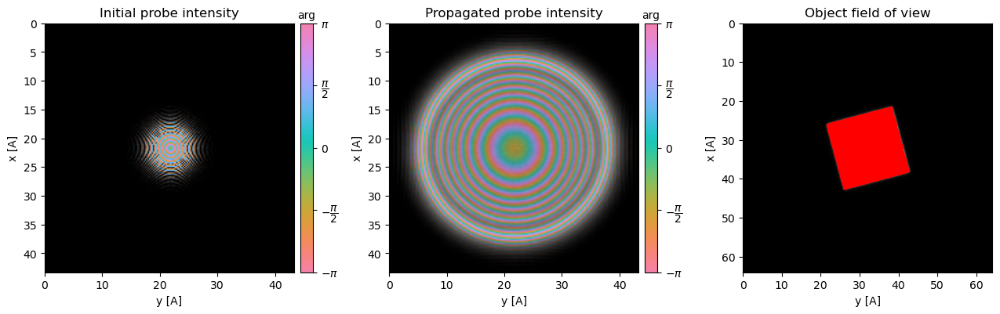

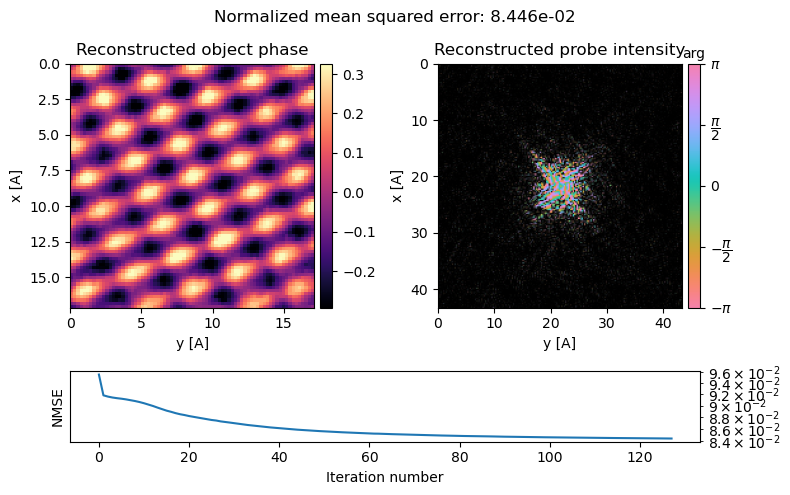

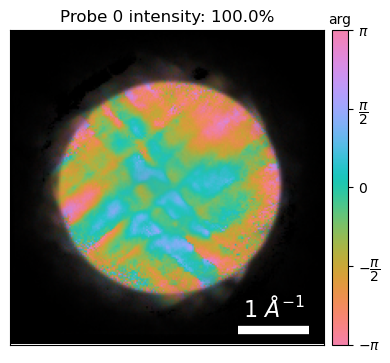

In [ ]:
mptychos_sweep_roll = []
mptychos_object = []
mptychos_object_fft = []
param_list = []

sweep_param = 2**(np.arange(0,5)*2)
tot_thickness = 750

for roll in sweep_param: 
    try:   
        ptycho1 = py4DSTEM.process.phase.MultislicePtychography(
            datacube=datacube_partial,
            energy=300e3,
            defocus=-15,
            vacuum_probe_intensity=probe_nparray,
            verbose=True,
            device='gpu', # uncomment if you have access to a GPU
            storage='cpu', # uncomment if you have access to a GPU
            semiangle_cutoff = 30,
            num_slices=5,
            slice_thicknesses=150,
        )

        ptycho = ptycho1.preprocess(
            plot_rotation=True,
            plot_center_of_mass = True,
            plot_probe_overlaps = True,
            # vectorized_com_calculation = False, # disable default CoM vectorized calc
            # store_initial_arrays= False, # don't store arrays necessary for reset=True
            max_batch_size= roll, # set max batch size for GPU memory
            clear_fft_cache=True, # clear the FFT cache to free GPU memory
        )
        ptycho00 = ptycho.reconstruct(
            num_iter = 128,
            seed_random=0,
            max_batch_size=roll,
            fix_probe = False,

        ).visualize(
        )
        ptycho.show_fourier_probe()

        ptychos_sweep_roll.append(ptycho00)

        ptychos_object.append(np.average(np.angle(ptycho00.object_cropped).copy(), axis = 0))
        ptychos_object_fft.append(ptycho00.object_fft)
        param_list.append(roll)
        plt.show()
    except Exception as e:
        print(f"Error with {roll}: {e}")
        continue


In [ ]:
sweep_param[-2]

64

In [ ]:
release_class_gpu_memory()

NameError: name 'release_class_gpu_memory' is not defined

In [ ]:
ptycho01 = py4DSTEM.process.phase.MultislicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=-15,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
    semiangle_cutoff = 30,
    num_slices=5,
    slice_thicknesses=150,
)

ptycho0 = ptycho01.preprocess(
    plot_rotation=True,
    plot_center_of_mass = True,
    plot_probe_overlaps = True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size= 64, # set max batch size for GPU memory
    clear_fft_cache=True, # clear the FFT cache to free GPU memory
)
ptycho001 = ptycho0.reconstruct(
    num_iter = 128,
    seed_random=0,
    max_batch_size=64,
    fix_probe = False,

).visualize(
)
ptycho001.show_fourier_probe()

# ptychos_sweep_roll.append(ptycho00)

# ptychos_object.append(np.average(np.angle(ptycho00.object_cropped).copy(), axis = 0))
# ptychos_object_fft.append(ptycho00.object_fft)
# param_list.append(roll)
plt.show()

CUDADriverError: CUDA_ERROR_ILLEGAL_ADDRESS: an illegal memory access was encountered

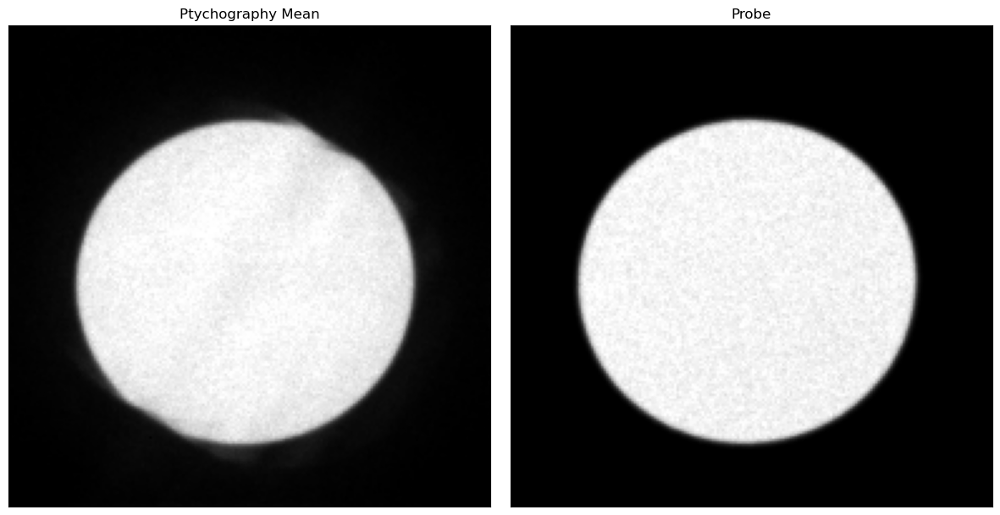

In [ ]:
datacube_partial.get_dp_mean()
py4DSTEM.show(
    [
        datacube_partial.tree('dp_mean').data,
        probe_masked.tree('dp_mean').data,
    ],
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title=['Ptychography Mean', 'Probe']
)

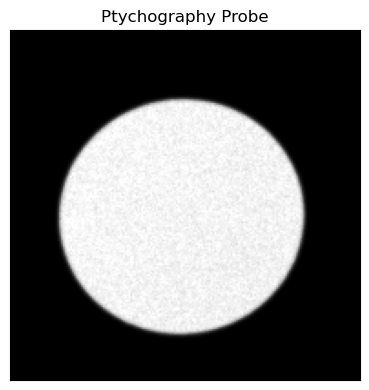

In [ ]:
py4DSTEM.show(
    probe_nparray,
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title='Ptychography Probe',

)

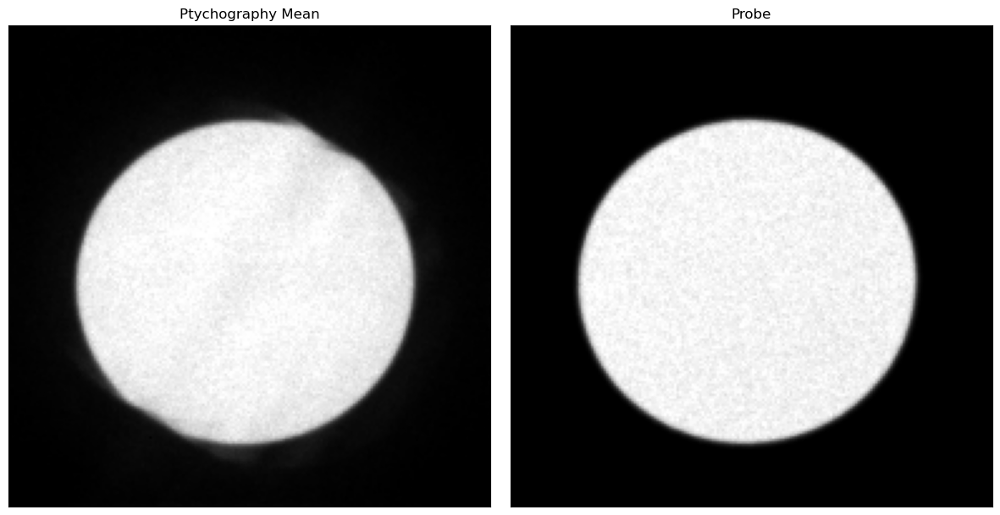

In [ ]:
datacube_partial.get_dp_mean()
py4DSTEM.show(
    [
        datacube_partial.tree('dp_mean').data,
        probe_masked.tree('dp_mean').data,
    ],
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title=['Ptychography Mean', 'Probe']
)

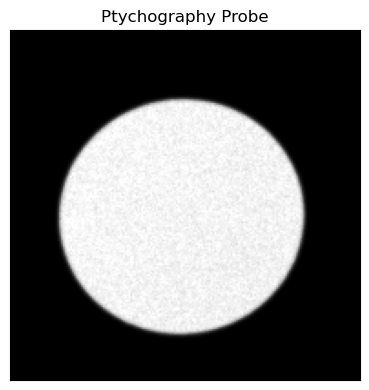

In [ ]:
py4DSTEM.show(
    probe_nparray,
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title='Ptychography Probe',

)

And investigate how the reconstruction quality degrades if one of rotation, defocus, reciprocal-space calibration is off by 15%

In [ ]:
import cupy as cp
from cupy.fft.config import get_plan_cache
mempool = cp.get_default_memory_pool()
pinned_mempool = cp.get_default_pinned_memory_pool()
cache = get_plan_cache()

def report_class_gpu_memory_usage(cls):

    size_on_device = 0
    for att in sorted(cls.__dict__):
        attr = getattr(cls,att)
        
        if isinstance(attr,(np.ndarray,cp.ndarray)):
            
            if get_array_module(attr) is not np:
                size_on_device += attr.nbytes
                print(f"Attribute {att}: {attr.nbytes*1e-3:.3f}Kb")
    
        if isinstance(attr,list) and isinstance(attr[0],(np.ndarray,cp.ndarray)):
            
            size_entering_loop = size_on_device
            for el in attr:
                if get_array_module(el) is not np:
                    size_on_device += el.nbytes
                    
            print(f"Attribute {att}: {(size_on_device-size_entering_loop)*1e-3:.3f}Kb")
    
    print(f"\nEstimated size on device: {size_on_device*1e-6:.3f}Mb")
    print(f"Reported size on device: {mempool.used_bytes()*1e-6:.3f}Mb")
    
    return None

def release_class_gpu_memory(clear_fft_cache = True):

    if clear_fft_cache is True:
        cache.clear()
        
    mempool.free_all_blocks()
    pinned_mempool.free_all_blocks()

    return None

cache.set_size(0)

In [ ]:
release_class_gpu_memory()

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3340.40probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:05<00:00, 354.13probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [15:31<00:00, 14.55s/ iter]


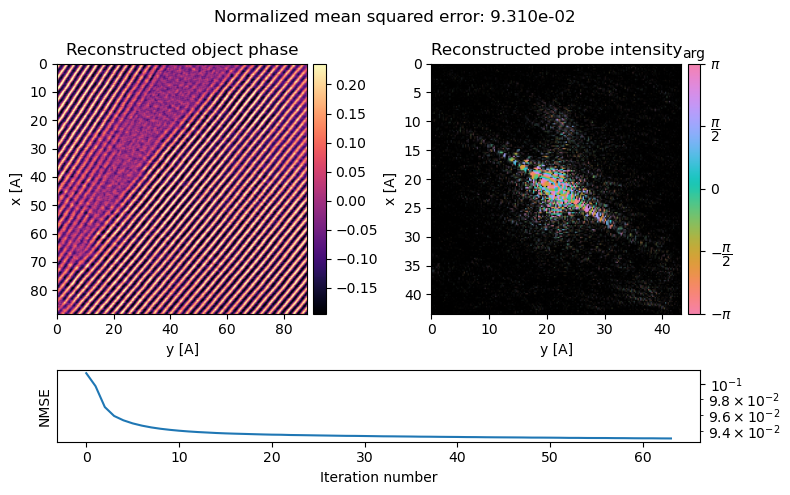

In [ ]:
mptycho_01 = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=4,
    semiangle_cutoff = 200,
    slice_thicknesses=20,
    datacube=dataset_masked,
    defocus=0,
    vacuum_probe_intensity=probe_nparray*10,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
)

mptycho = mptycho_01.preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)


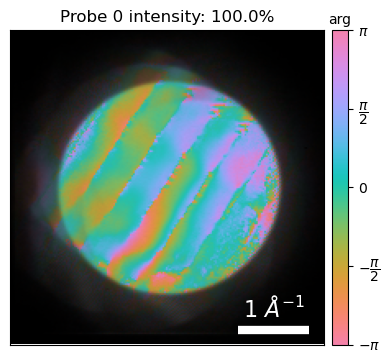

In [ ]:
mptycho.show_fourier_probe()

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3335.38probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:06<00:00, 351.32probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5.
Reconstructing object and probe:   0%|          | 0/64 [00:50<?, ? iter/s]


OutOfMemoryError: Out of memory allocating 38,654,705,664 bytes (allocated so far: 106,422,131,712 bytes).

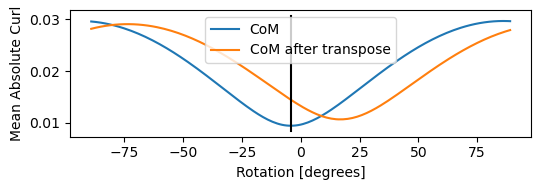

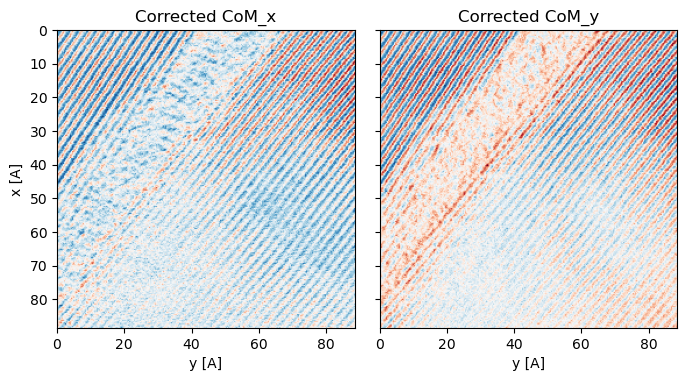

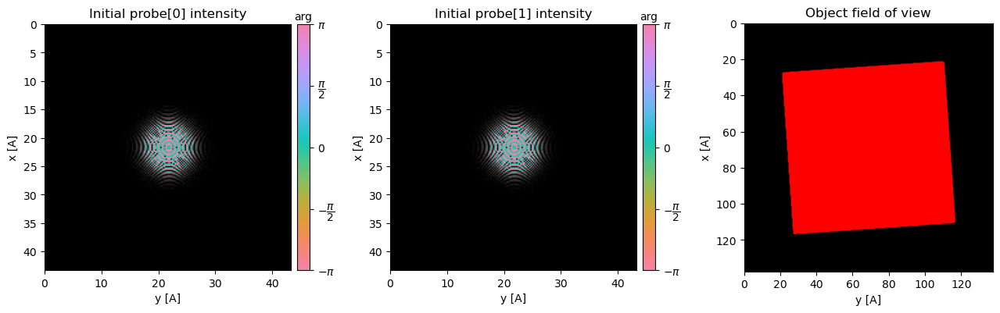

In [ ]:
ptycho_01_mixed = py4DSTEM.process.phase.MixedstatePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=0,
    vacuum_probe_intensity= probe_nparray,
    verbose=True,
    num_probes=2,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
    semiangle_cutoff=30,
)


Calculating center of mass: 100%|██████████| 65536/65536 [00:21<00:00, 3052.07probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:07<00:00, 349.51probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [09:38<00:00,  9.04s/ iter]


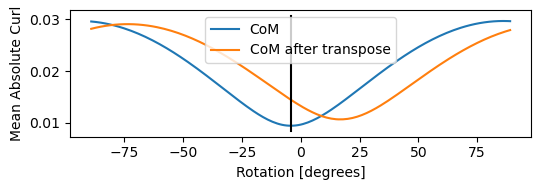

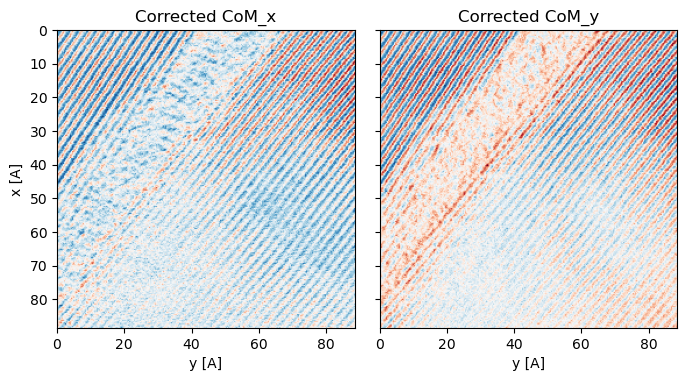

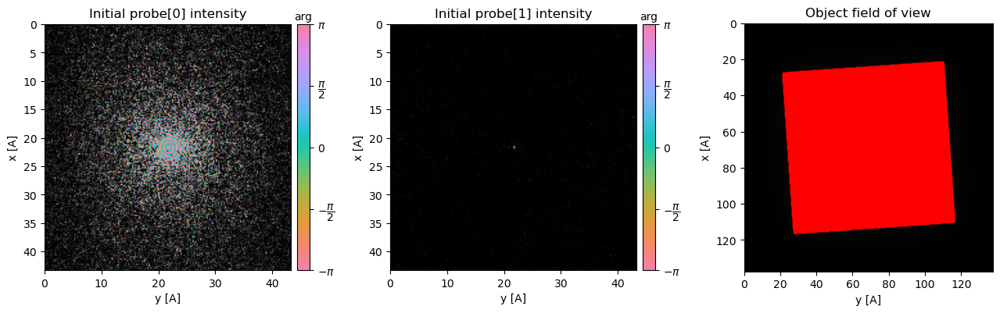

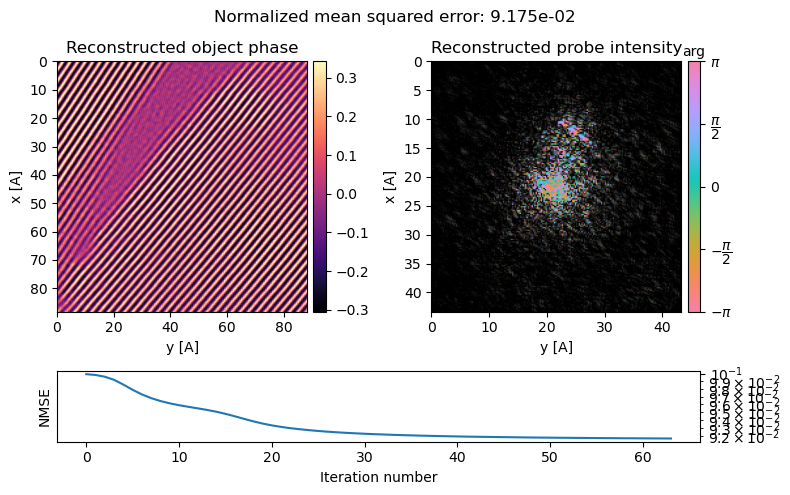

In [ ]:
ptycho_mixed = ptycho_01_mixed.preprocess(
    plot_center_of_mass = True,
    plot_rotation=True,
    plot_probe_overlaps=True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size= 128, # set max batch size for GPU memory
)

ptycho_mixed_00 = ptycho_mixed.reconstruct(
    num_iter = 64,
    seed_random=2024,
    max_batch_size=512,
).visualize(
)

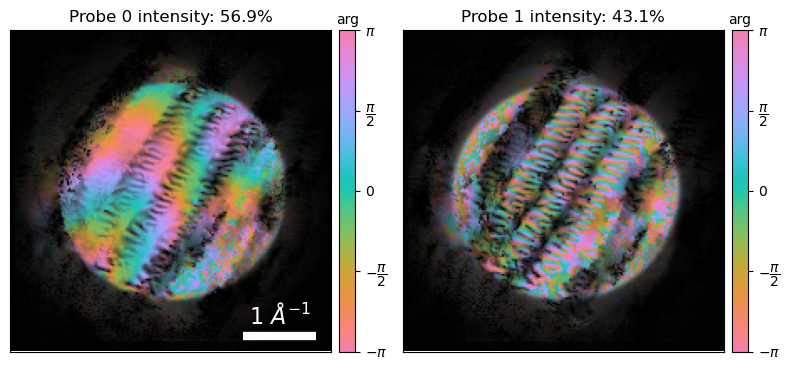

In [ ]:
ptycho_mixed.show_fourier_probe()

In [ ]:
mptycho

In [ ]:
# try:
#     for i in range(10):
#         release_class_gpu_memory()
# except:
#     for i in range(10):
#         release_class_gpu_memory()

mptycho_computational_intense = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=0,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = True,
    plot_rotation=True,
    plot_probe_overlaps=True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

CUDADriverError: CUDA_ERROR_UNKNOWN: unknown error

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3356.34probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:06<00:00, 350.84probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [18:08<00:00, 17.00s/ iter]


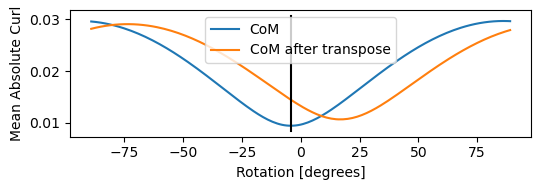

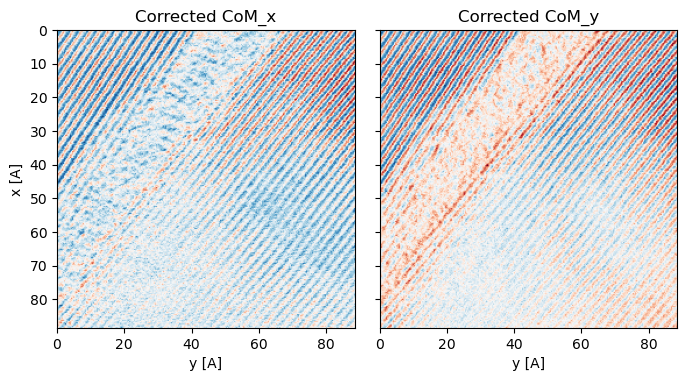

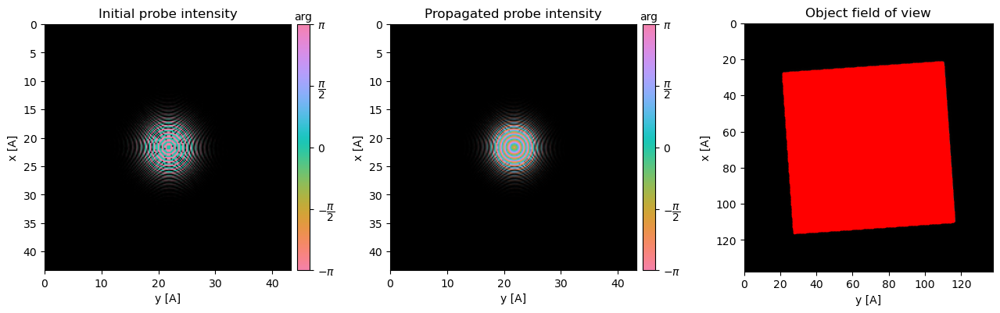

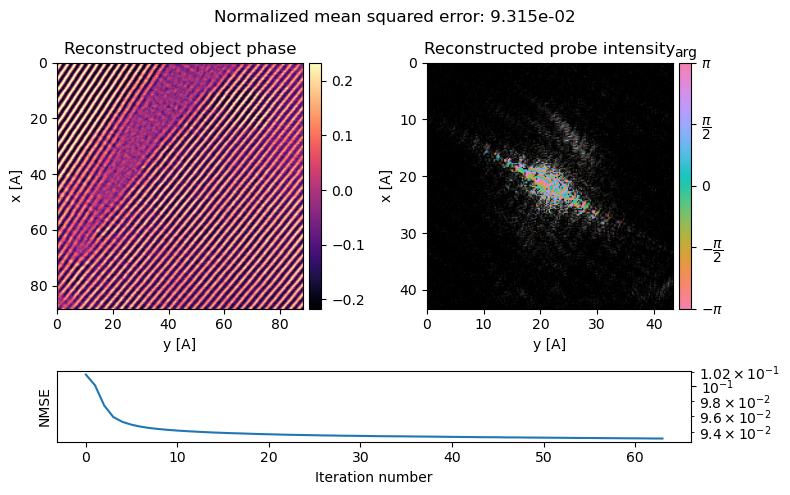

In [ ]:
mptycho_intense = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=5,
    slice_thicknesses=10,
    datacube=dataset_masked,
    defocus=0,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = True,
    plot_rotation=True,
    plot_probe_overlaps=True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3360.91probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:06<00:00, 350.86probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [07:09<00:00,  6.71s/ iter]


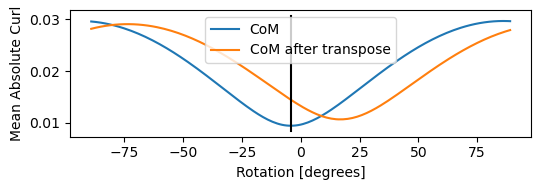

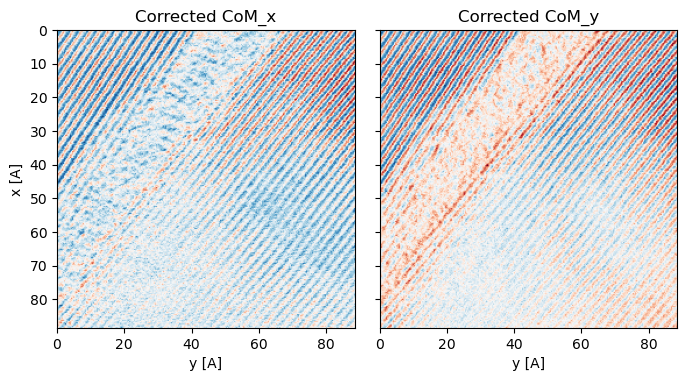

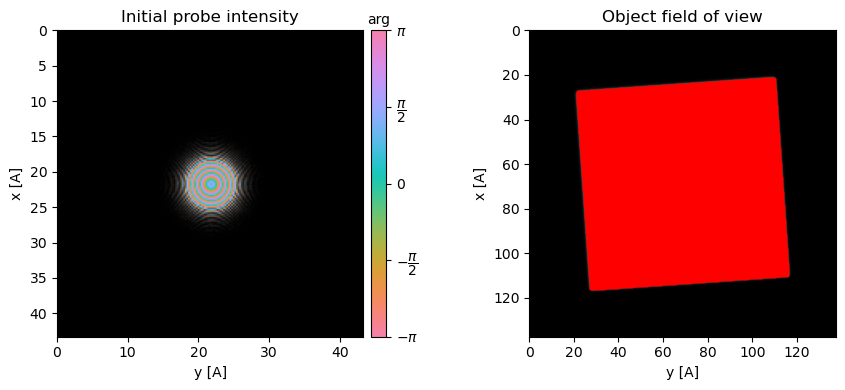

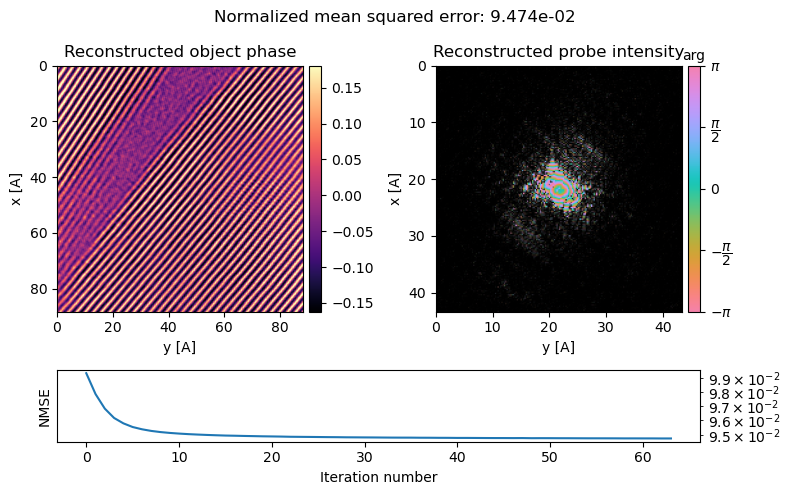

In [ ]:
ptycho_bad_defoc = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=50,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = True,
    plot_rotation=True,
    plot_probe_overlaps=True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3345.53probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:07<00:00, 349.99probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [18:08<00:00, 17.01s/ iter]


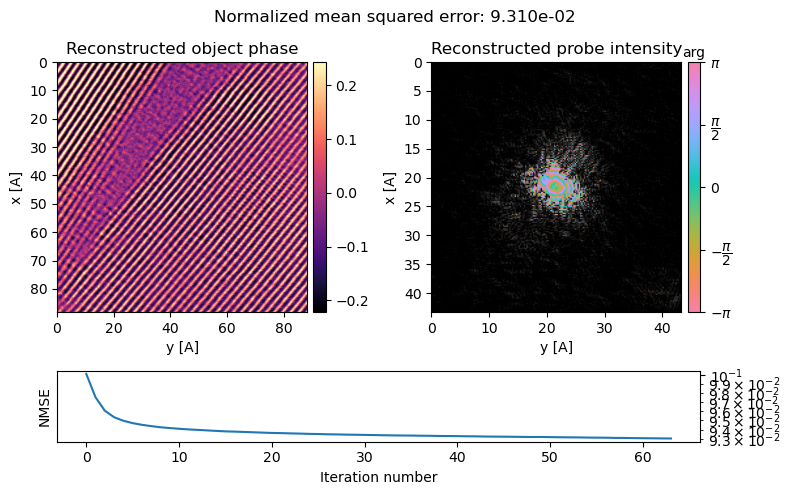

In [ ]:
mptycho_bad_Defoc = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=5,
    slice_thicknesses=10,
    datacube=dataset_masked,
    defocus=50,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3337.93probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:08<00:00, 347.66probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [07:11<00:00,  6.74s/ iter]


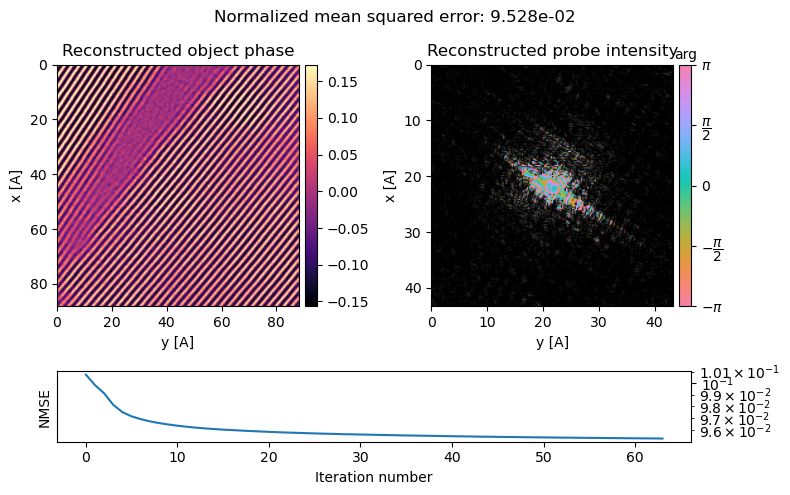

In [ ]:
ptycho_bad_defoc2 = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=-50,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3328.92probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:26<00:00, 317.80probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [18:09<00:00, 17.02s/ iter]


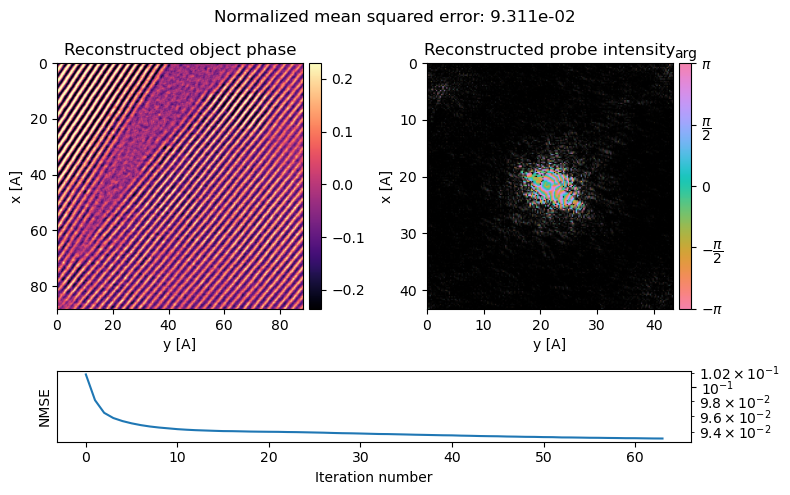

In [ ]:
mptycho_bad_Defoc2 = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=5,
    slice_thicknesses=50,
    datacube=dataset_masked,
    defocus=-50,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

In [ ]:
mptycho_thick_1 = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=6,
    slice_thicknesses=100,
    datacube=dataset_masked,
    defocus=0,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size=512,
)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3353.78probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:08<00:00, 346.89probe position/s]


Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [20:52<00:00, 19.57s/ iter]


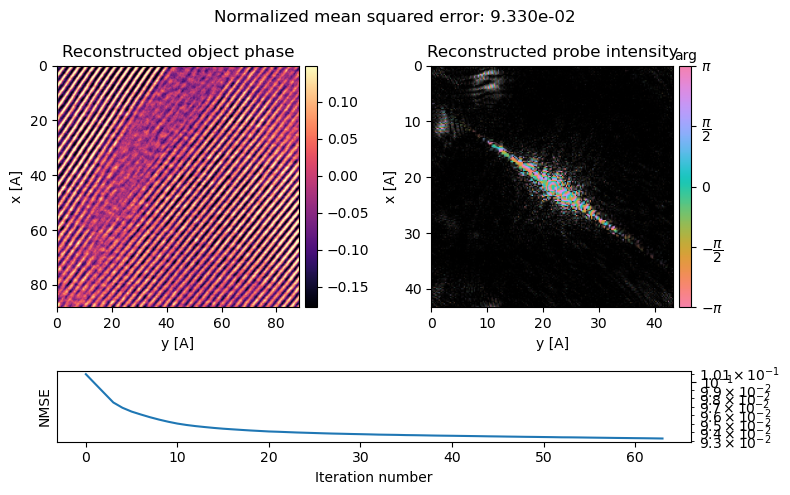

In [ ]:
mtycho_thick = mptycho_thick_1.reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

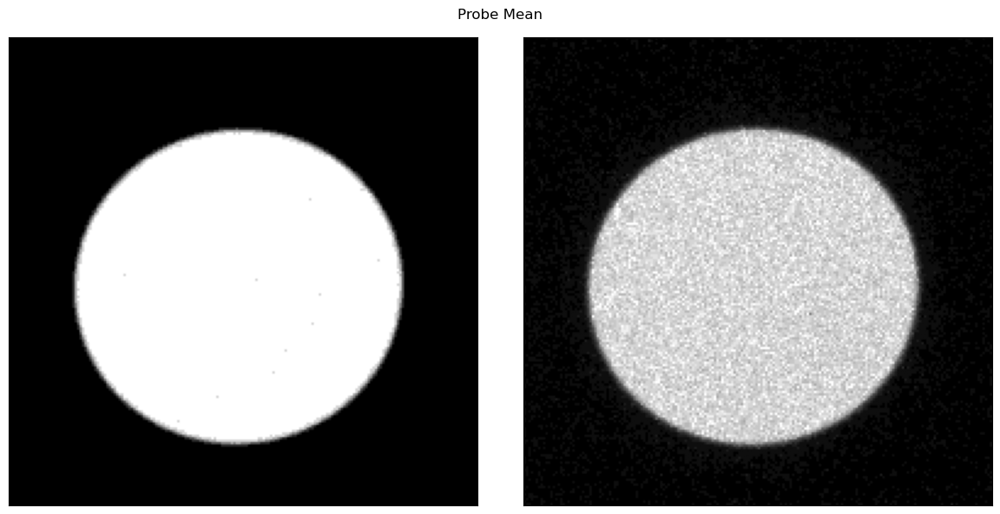

In [ ]:
py4DSTEM.show(
    [
        probe_nparray,
        probe_masked.tree('dp_max').data
    ],
    cmap='gray',
    figsize=(4,4),
    ticks=False,
    title='Probe Mean',
)

In [ ]:
raise SystemExit('End of script reached. No further processing will be done.')

SystemExit: End of script reached. No further processing will be done.

To exit: use 'exit', 'quit', or Ctrl-D.


Reconstructing object and probe: 100%|██████████████████████████████████████| 64/64 [00:37<00:00,  1.68 iter/s]


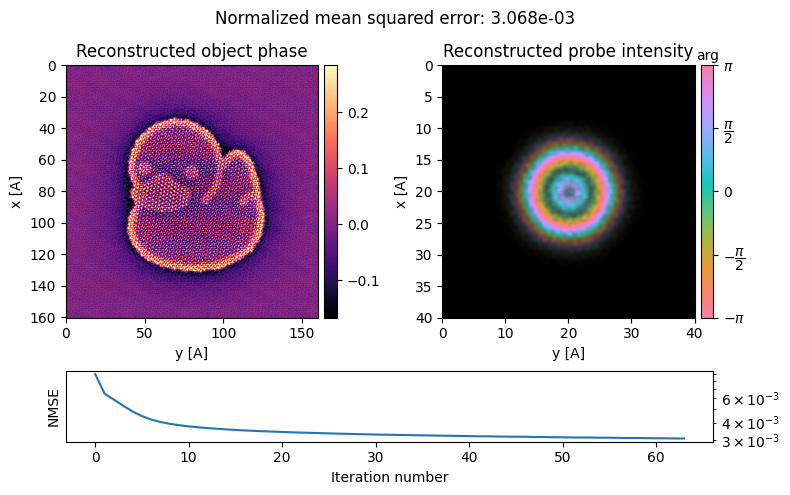

In [ ]:
ptycho_wrong_rotation = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset,
    energy=80e3,
    defocus=500,
    vacuum_probe_intensity=probe.data,
    verbose=False,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    plot_center_of_mass = False,
    force_com_rotation = -15*0.85,
    plot_probe_overlaps=False,
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

Reconstructing object and probe: 100%|██████████████████████████████████████| 64/64 [00:38<00:00,  1.68 iter/s]


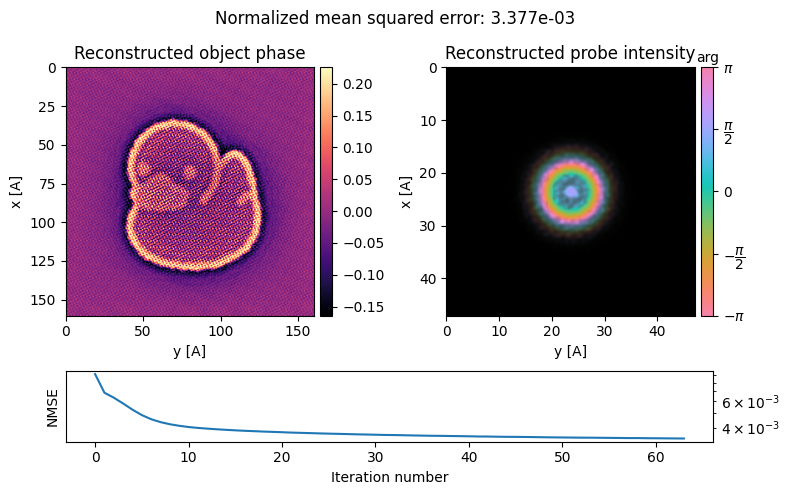

In [ ]:
ptycho_wrong_pixelsize = py4DSTEM.process.phase.SingleslicePtychography(
    datacube=dataset,
    energy=80e3,
    defocus=500,
    vacuum_probe_intensity=probe.data,
    verbose=False,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
).preprocess(
    force_reciprocal_sampling=0.025*0.85,
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)

It's interesting to note how more sensitive some calibrations are over others, and how different the failure modes are!

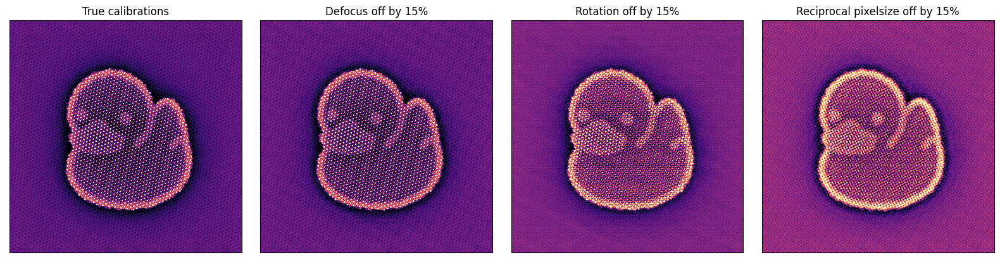

In [ ]:
py4DSTEM.show(
    [
        np.angle(ptycho.object_cropped),
        np.angle(ptycho_wrong_defocus.object_cropped),
        np.angle(ptycho_wrong_rotation.object_cropped),
        np.angle(ptycho_wrong_pixelsize.object_cropped),
    ],
    cmap='magma',
    ticks=False,
    title=["True calibrations","Defocus off by 15%","Rotation off by 15%","Reciprocal pixelsize off by 15%"],
    axsize=(4,4),
)

### Ptychography Optimizer & Optimization Parameter

As we've seen all ptychographic functions in py4DSTEM follow the framework:
```python
XxPtychography(
    **init_args
).preprocess
    **preprocess_args
).reconstruct(
    **reconstruction_args
)
```

The optimizer is thus built around this framework and accepts the ptychographic class as its first argument, followed by the init, preprocess, and reconstruction argument dictionaries
```python
PtychographyOptimizer(
    XxPtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = reconstruction_args,
)
```

In each dictionary, parameters to be optimized are passed wrapped in an `OptimizationParameter` object, specified as 
```python
OptimizationParameter(
    initial_value,
    lower_bound,
    upper_bound,
)
```
`OptimizationParameter` assumes parameters are real numbers by default, but also supports boolean and integer arguments using the `space` keyword argument. 

Let's translate the ducky parameters to these dictionaries. We'll start with the reciprocal pixel-size, since it's so sensitive.

In [92]:
from py4DSTEM.process.phase.parameter_optimize import OptimizationParameter, PtychographyOptimizer

init_args = {
    'datacube':dataset,
    'energy':300e3,
    'vacuum_probe_intensity':probe.data,
    'device':'gpu',
    'storage':'cpu',
    'defocus': -110,# OptimizationParameter(0,-150, -100), # defocus in A
    'num_slices':5,
    'slice_thicknesses': 250, #59.571678348419034, # slice thickness in A
    'middle_focus':True,
}

preprocess_args = {
    # 'force_reciprocal_sampling':0.25,
    'force_com_rotation': OptimizationParameter(-14,-15,15),
    'force_com_transpose': False,
    'vectorized_com_calculation' : False, # disable default CoM vectorized calc
    # 'store_initial_arrays' : False, # don't store arrays necessary for reset=True
}

recon_args = {
    'num_iter':128,
    'max_batch_size':512,
}

optimizer = PtychographyOptimizer(
    py4DSTEM.process.phase.MultislicePtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = recon_args,
)

### Grid-search
The simplest optimization is to perform a grid-search. This ignores the `initial_value` argument of `OptimizationParameter` and instead evaluates the ptychography model using equally-distributed `n_points` between the `lower_bound` and `upper_bound`.

In [93]:
import matplotlib.pyplot as plt

In [94]:
import datetime
def now_str():
    return datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")

Searching parameters: 100%|██████████| 4/4 [04:04<00:00, 61.10s/it]


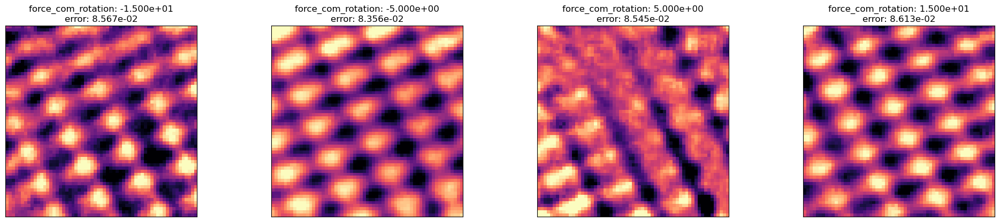

In [95]:
objects = optimizer.grid_search(
    n_points=(4,),
    error_metric="linear",
    plot_reconstructed_objects=True,
    # return_reconstructed_objects=False,
    return_reconstructed_objects = True,
    plot_reconstructed_objects_fft=False,
    figsize=(25,8),
    ncols = 5,
)
plt.savefig('..\\pictures\\' +now_str()+ 'multiptycho_grid_search_rot.png', dpi=300, bbox_inches='tight')

In [51]:
objects[2]

(array([[-0.13968486, -0.05265689,  0.02499703, ..., -0.10832636,
         -0.15236086, -0.17066576],
        [-0.10546145, -0.02669449,  0.03220776, ..., -0.17846152,
         -0.23745637, -0.26428962],
        [-0.02381966,  0.05736569,  0.1104024 , ..., -0.1892538 ,
         -0.25522345, -0.2903524 ],
        ...,
        [-0.01838874, -0.07410541, -0.1753044 , ..., -0.04116651,
         -0.00127811,  0.02614442],
        [-0.01185248, -0.05039191, -0.13824785, ..., -0.09080442,
         -0.02939254, -0.00123852],
        [ 0.0157618 , -0.00796545, -0.06702363, ..., -0.13145196,
         -0.07137504, -0.02436542]], dtype=float32),
 0.08306336402893066)

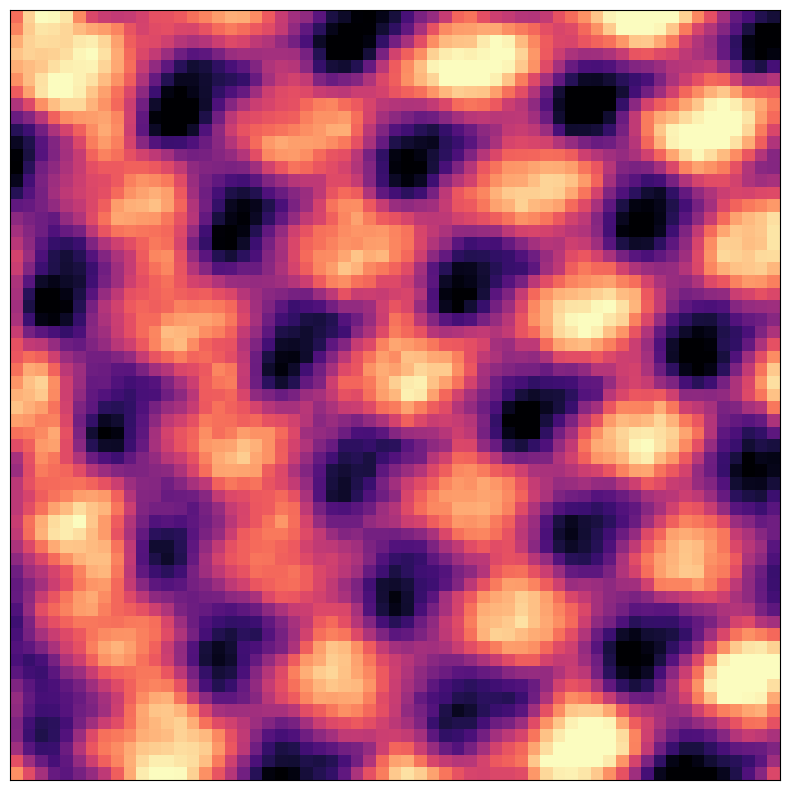

In [54]:
py4DSTEM.show(
    objects[0][0],
    cmap='magma',
    ticks=False,
    figsize=(25,8),
)

We can see the true calibrations demonstrate a global minimum (although note we used a rather aggressive range).

### Bayesian-Optimization with Gaussian Processes

Alternatively, we can perform a more efficient search using Bayesian optimization with Gaussian processes (as implemented in [scikit-optimize](https://scikit-optimize.github.io/stable/)).

In [ ]:
optimizer.optimize(
    n_calls=30,
    n_initial_points=15,
    error_metric='log',
)
optimizer = optimizer.visualize()
plt.savefig('..\\pictures\\' +now_str()+ 'multiptycho_grid_search_slice_thickness.png', dpi=300, bbox_inches='tight')

Optimizing parameters:   0%|          | 0/30 [00:00<?, ?it/s]

We can also optimize more than one parameters at a time (although note this is not always advisable).  
Here, we optimize defocus and rotation jointly and plot the partial dependence of each parameter on the error metric.

In [86]:
preprocess_args

{'force_com_rotation': <py4DSTEM.process.phase.parameter_optimize.OptimizationParameter at 0x1f5075c8a10>,
 'force_com_transpose': False,
 'vectorized_com_calculation': False}

In [82]:
# Replace/add Optimization parameters in the argument dictionaries
preprocess_args.pop('slice_thickness',50)
# preprocess_args['slice_thicknesses'] = 41
init_args['defocus']=OptimizationParameter(-110,-300,175)
preprocess_args['force_com_rotation']=OptimizationParameter(7,-15,30)

optimizer_defocus_thickness = PtychographyOptimizer(
    py4DSTEM.process.phase.MultislicePtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = recon_args,
)

optimizer_defocus_thickness.optimize(
    n_calls=80,
    n_initial_points=15,
    error_metric='log',
)
optimizer_defocus_thickness = optimizer_defocus_thickness.visualize()
plt.savefig('..\\pictures\\' +now_str()+ 'multiptycho_grid_search_slice_defoc_rot.png', dpi=300, bbox_inches='tight')

Optimizing parameters:  40%|████      | 32/80 [33:17<49:55, 62.41s/it]  


ValueError: Input y contains NaN.

In [ ]:
# Replace/add Optimization parameters in the argument dictionaries
# preprocess_args.pop('force_reciprocal_sampling',None)
# preprocess_args['slice_thicknesses'] = 41
preprocess_args.pop('defocus',-110)
preprocess_args.pop('force_com_rotation',-15)
init_args['slice_thickness']=OptimizationParameter(-110,-300,175)
preprocess_args['num_slices'] = OptimizationParameter(5,2,10)

optimizer_defocus_rotation = PtychographyOptimizer(
    py4DSTEM.process.phase.MultislicePtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = recon_args,
)

optimizer_defocus_rotation.optimize(
    n_calls=80,
    n_initial_points=15,
    error_metric='log',
)
optimizer_defocus_rotation = optimizer_defocus_rotation.visualize()
plt.savefig('..\\pictures\\' +now_str()+ 'multiptycho_grid_search_slice_rot_thickness.png', dpi=300, bbox_inches='tight')

Notice how the optimized result is not in-fact the true calibration of 500 A defocus!  
This highlights the risks of blindly using the self-consistency error as an optimization function. To remedy this, `optimize` function accepts an `error_metric` argument, with a variety of predefined and custom metrics.